# Assignment 1: Optical flow

In [2]:
import numpy as np
import cv2
from ex1_utils import gaussderiv, rotate_image, show_flow, gausssmooth
import matplotlib.pyplot as plt
from timeit import default_timer as timer

In [3]:
# Function for subplotting for tests
def subplot_field_lk(im1, im2, N, sigma,harris, title=""):
    fig1, ax = plt.subplots(2, 2, figsize=(15, 10))

    ax1_11, ax1_12 = ax[0]
    ax1_21, ax1_22 = ax[1]

    ax1_11.imshow(im1)
    ax1_12.imshow(im2)

    U, V = lucaskanade(im1, im2, N,sigma, harris)
    show_flow(U, V, ax1_21, type="angle")
    show_flow(U, V, ax1_22, type="field", set_aspect=True)

    fig1.suptitle(title)
    
    plt.show()

# Function for subplotting for tests
def subplot_field_hc(im1, im2, n_iters,lmbd , sigma,convergence_tresh, title="", u_start=[], v_start=[]):
    fig1, ax = plt.subplots(2, 2, figsize=(15, 10))

    ax1_11, ax1_12 = ax[0]
    ax1_21, ax1_22 = ax[1]

    ax1_11.imshow(im1)
    ax1_12.imshow(im2)

    U, V = hornschunck(im1,im2, n_iters, lmbd, sigma, convergence_tresh, u_start, v_start)
    show_flow(U, V, ax1_21, type="angle")
    show_flow(U, V, ax1_22, type="field", set_aspect=True)


    fig1.suptitle(title)

    plt.show()


## Base functions

In [20]:
def lucaskanade (im1, im2, N,sigma = 1, include_harris=False):
    """Function for calculating the optical flow using the Lucas-Kanade method"""
    # defined a sigma that changes with the size of the image, for appropriate derivatives
    Ix1,Iy1 = gaussderiv(im1, sigma)
    Ix2,Iy2 = gaussderiv(im2, sigma)
    Ix = (Ix1 + Ix2)/2.0
    Iy = (Iy1 + Iy2)/2.0
    # Get the time derivative, add gaussian smoothing
    It = gausssmooth(im2-im1, sigma)
    sum_kernel = np.ones(shape=(N,N), dtype=np.float32)
    # Calculate sums of squared derivative images
    sum_Ix2 = cv2.filter2D(src=Ix*Ix, ddepth=-1, kernel=sum_kernel)
    sum_Iy2 = cv2.filter2D(src=Iy*Iy, ddepth=-1, kernel=sum_kernel)
    sum_Ix_Iy = cv2.filter2D(src=Ix*Iy, ddepth=-1, kernel=sum_kernel)
    sum_Ix_It = cv2.filter2D(src=Ix*It, ddepth=-1, kernel =sum_kernel)
    sum_Iy_It = cv2.filter2D(src=Iy*It, ddepth=-1, kernel =sum_kernel)

    # Calculate the determinant
    D = sum_Ix2 * sum_Iy2 - sum_Ix_Iy * sum_Ix_Iy 
    u = np.zeros(shape=im1.shape)
    v = np.zeros(shape=im1.shape)

    if include_harris:
        # Harris criterion for corner detection
        K = 0.05
        trace = sum_Ix2 + sum_Iy2
        c = D -  K * trace**2
        # Treshold to consider where the criterion is low
        tresh = 1e-6
   
        indices = np.where((c > tresh) & (np.abs(D) != 0))

        u[indices] =  - (sum_Iy2[indices] * sum_Ix_It[indices] -  sum_Ix_Iy[indices] * sum_Iy_It[indices])/D[indices]
        v[indices] = - (sum_Ix2[indices] * sum_Iy_It[indices] - sum_Ix_Iy[indices] * sum_Ix_It[indices])/D[indices]
    
    else:
        # Get the flow field
        indices = np.where(D != 0)

        u[indices] =  - (sum_Iy2[indices] * sum_Ix_It[indices] -  sum_Ix_Iy[indices] * sum_Iy_It[indices])/D[indices]
        v[indices] = - (sum_Ix2[indices] * sum_Iy_It[indices] - sum_Ix_Iy[indices] * sum_Ix_It[indices])/D[indices]
    
    return u,v

def hornschunck (im1, im2, n_iters, lmbd, sigma, convergence_tresh=-1, start_u = [], start_v = []):
    """Function for calculating the optical flow using the Horn-Schnuck method"""
    # defined a sigma that changes with the size of the image, for appropriate derivatives
    # lambda is the parameter to determine the amount of effect of smoothnes
    im1 = gausssmooth(im1, sigma)
    im2 = gausssmooth(im2, sigma)
    Ix, Iy = gaussderiv((im1+im2)/2, sigma) 
    # Get the time derivative
    It =gausssmooth(im2-im1, sigma)
    # Initialize u,v start with zeros
    u = start_u
    v = start_v
    if len(u) == 0:
        u = np.zeros(shape = im1.shape)
    
    if len(v) == 0:
        v = np.zeros(shape = im1.shape)

    # Laplacian kernel
    Ld = np.array([[0,0.25,0],[0.25,0,0.25], [0,0.25,0]])

    for n in range(n_iters):
        ua = cv2.filter2D(u, -1,Ld)
        va = cv2.filter2D(v, -1, Ld) 

        P = Ix * ua + Iy* va + It
        D = lmbd + Ix*Ix + Iy*Iy

        u_tmp = ua - Ix * P/D
        v_tmp = va - Iy * P/D

        # Define convergence 
        avg_diff = (np.sum((u-u_tmp)**2 + (v-v_tmp)**2)) /(im1.shape[0] * im1.shape[1])
        # minimal iterations = 100
        if n > 1 and avg_diff < convergence_tresh:
            break

        u = u_tmp
        v = v_tmp
    print(n)


    return u,v

## Testing base functions on noise

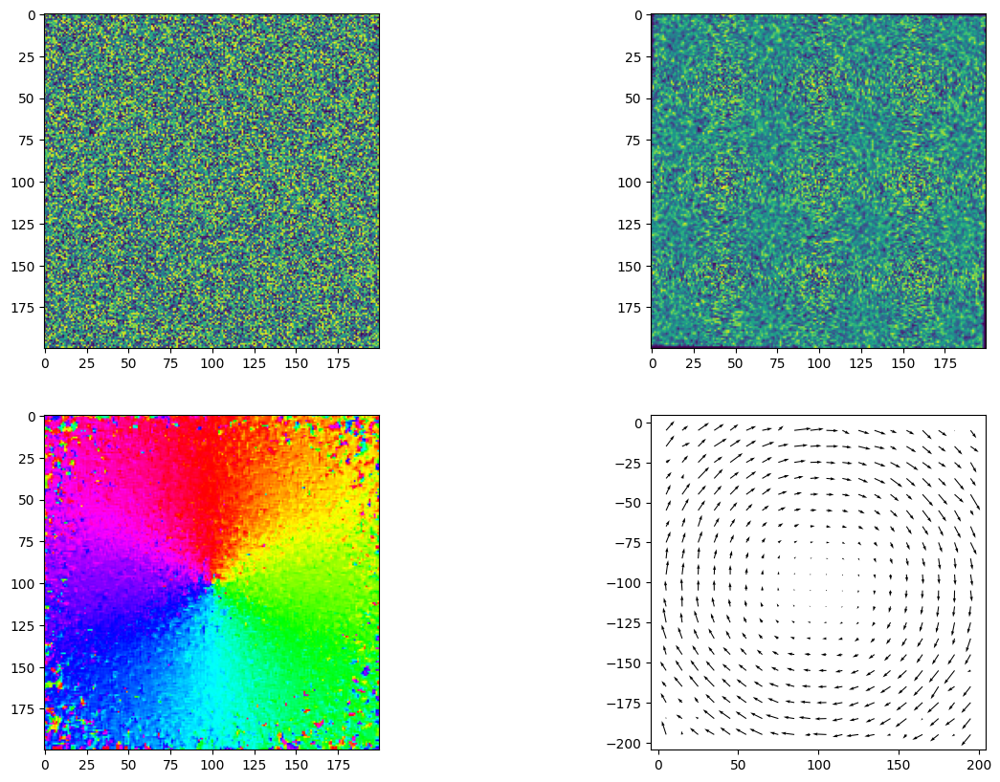

211


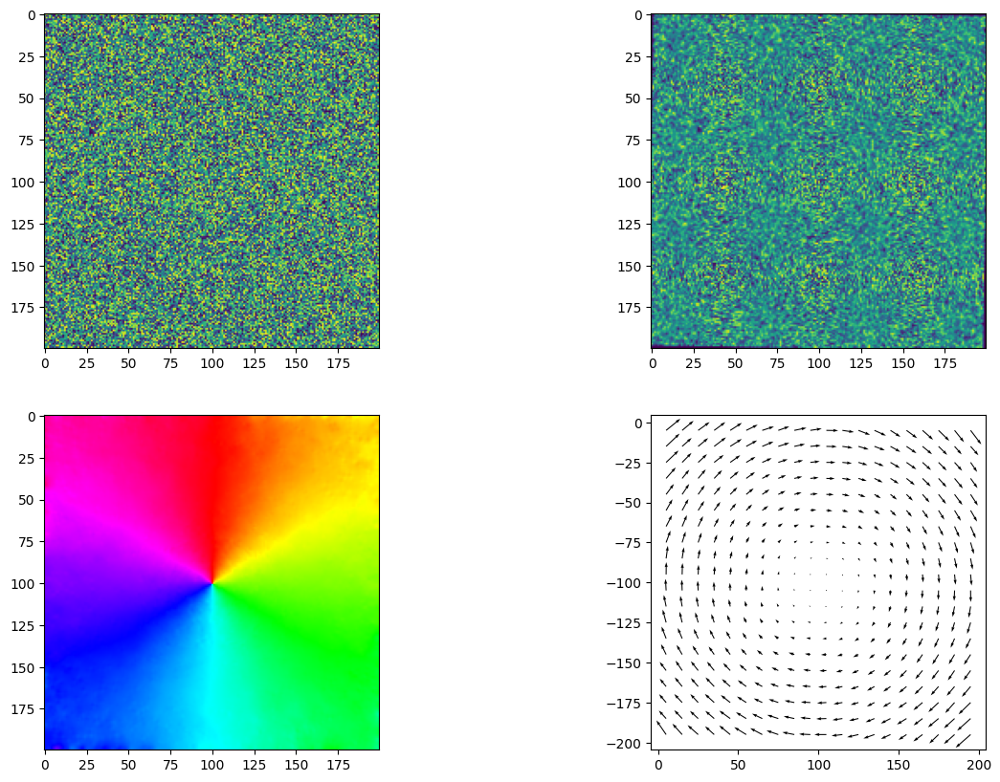

In [5]:
# Testing on noise
# As seen on the image 
np.random.seed(42)
im1 = np.random.rand(200,200).astype(np.float32)
im2 = im1.copy()
im2 = rotate_image(im2,-1)
# using these parameters gives a nicer optical flow
sigma = im1.shape[0] /250
N = 3 #for LK
lmbd = .5 #for HS
subplot_field_lk(im1,im2, N=N, harris=False,sigma=sigma)
subplot_field_hc(im1,im2,10000, lmbd, sigma, 1e-6)

## Testing base function on video

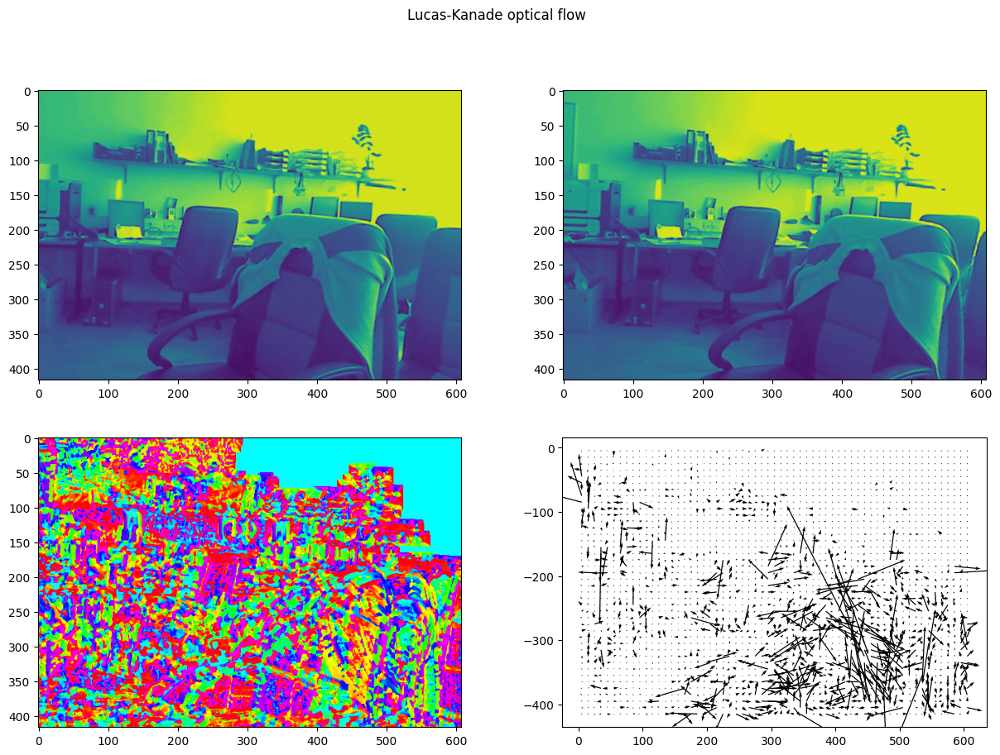

934


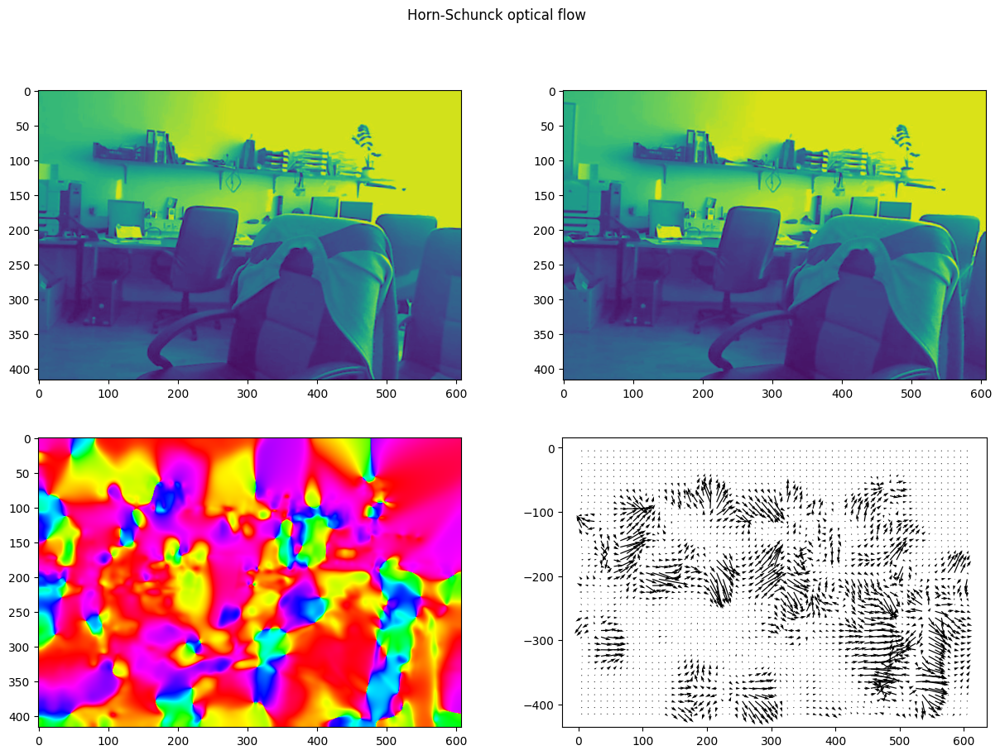

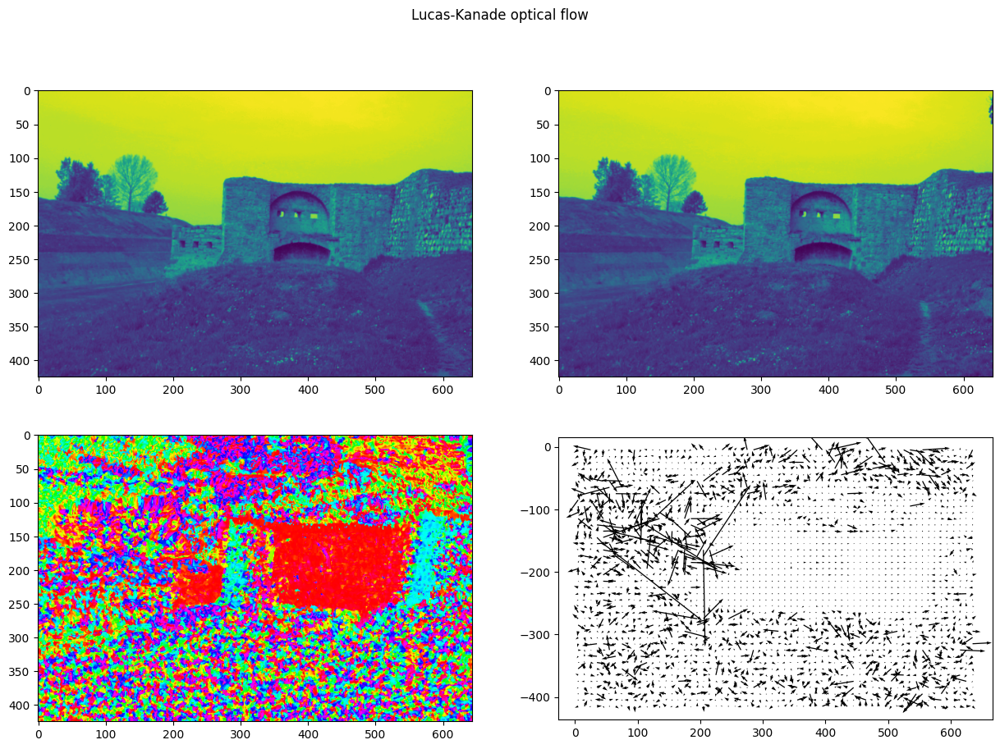

516


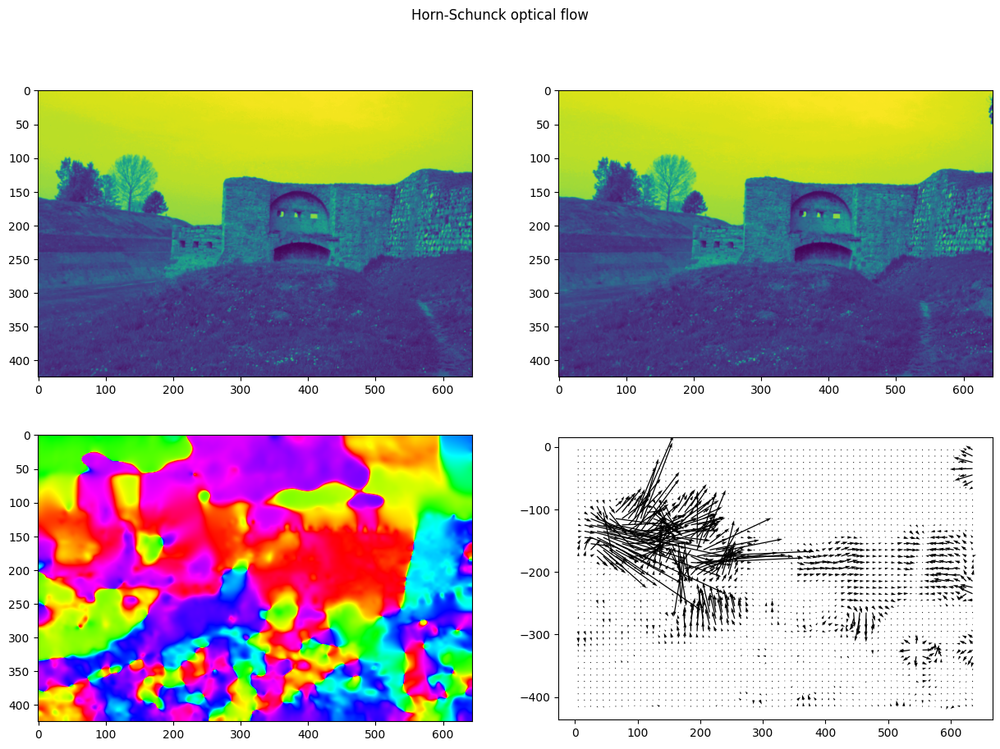

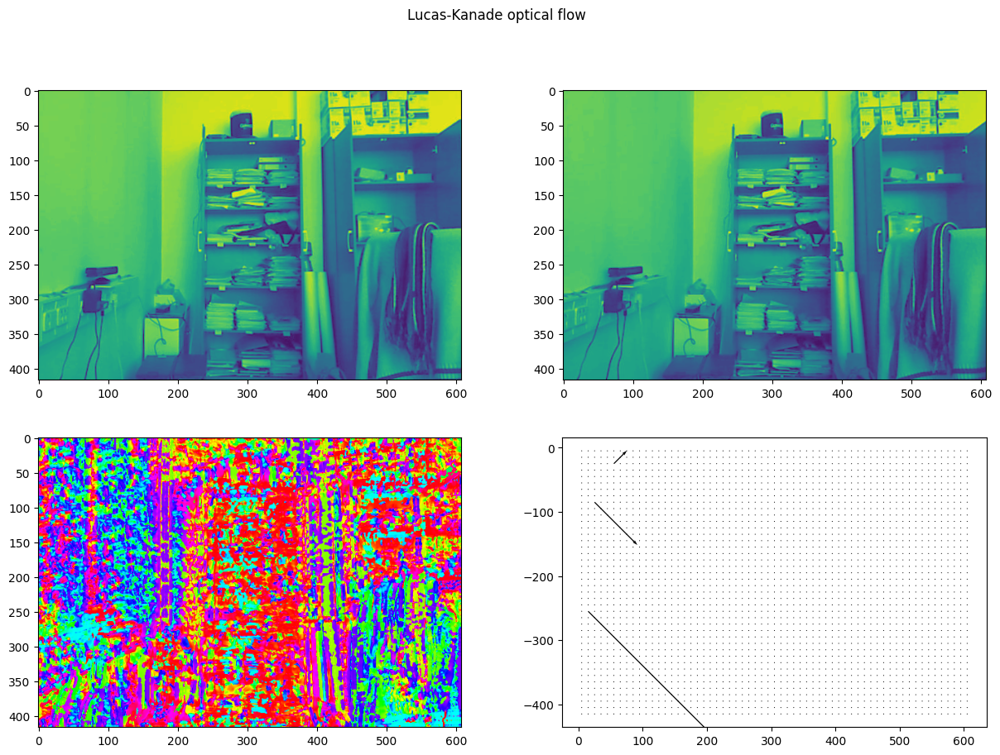

1143


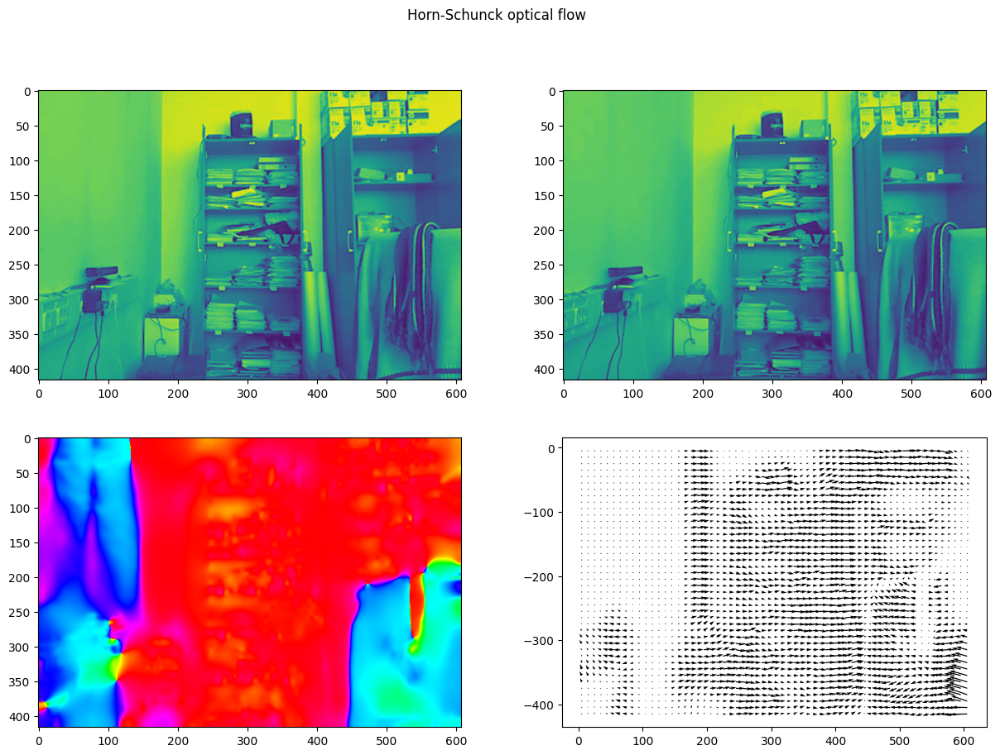

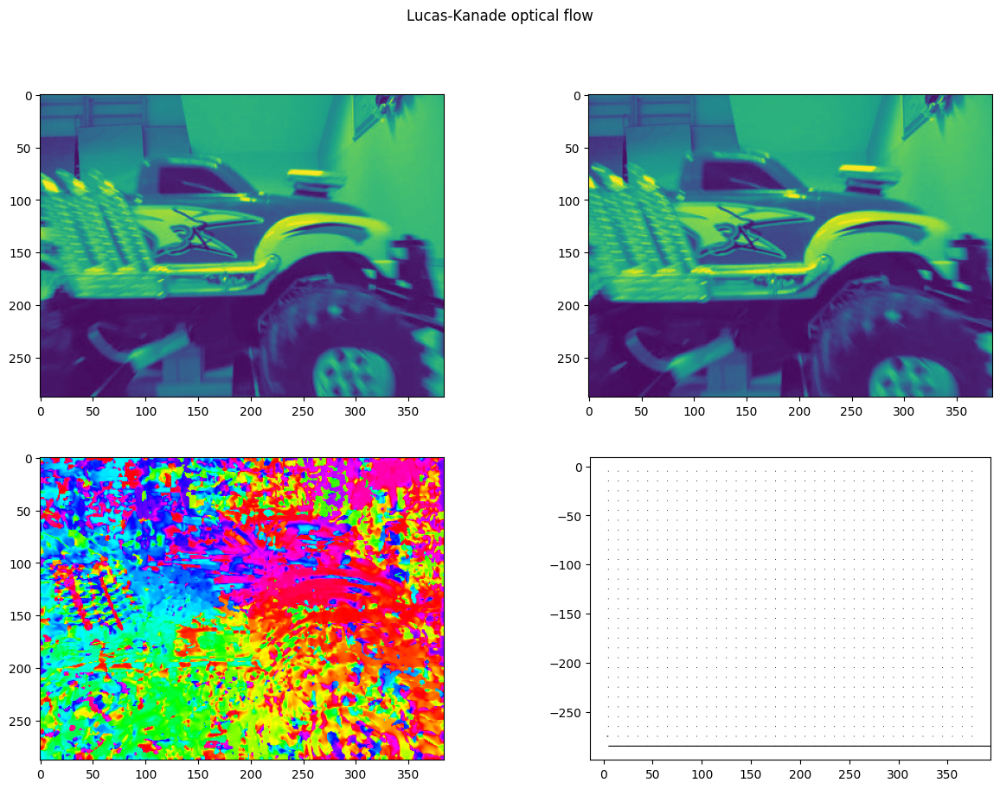

1206


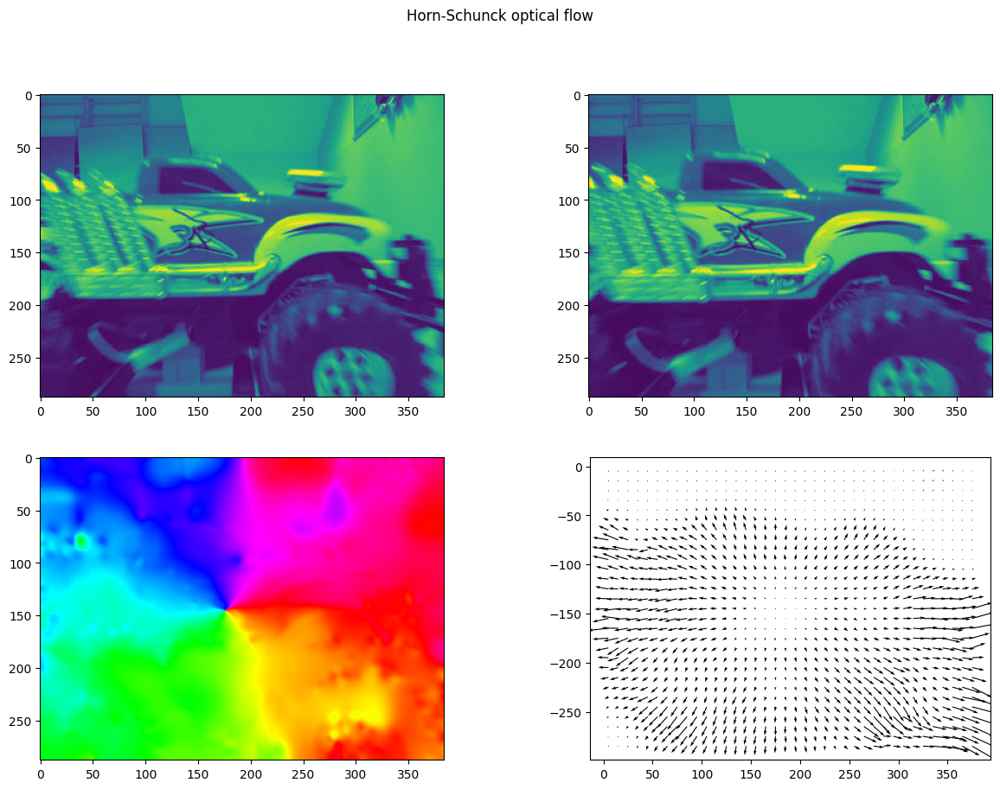

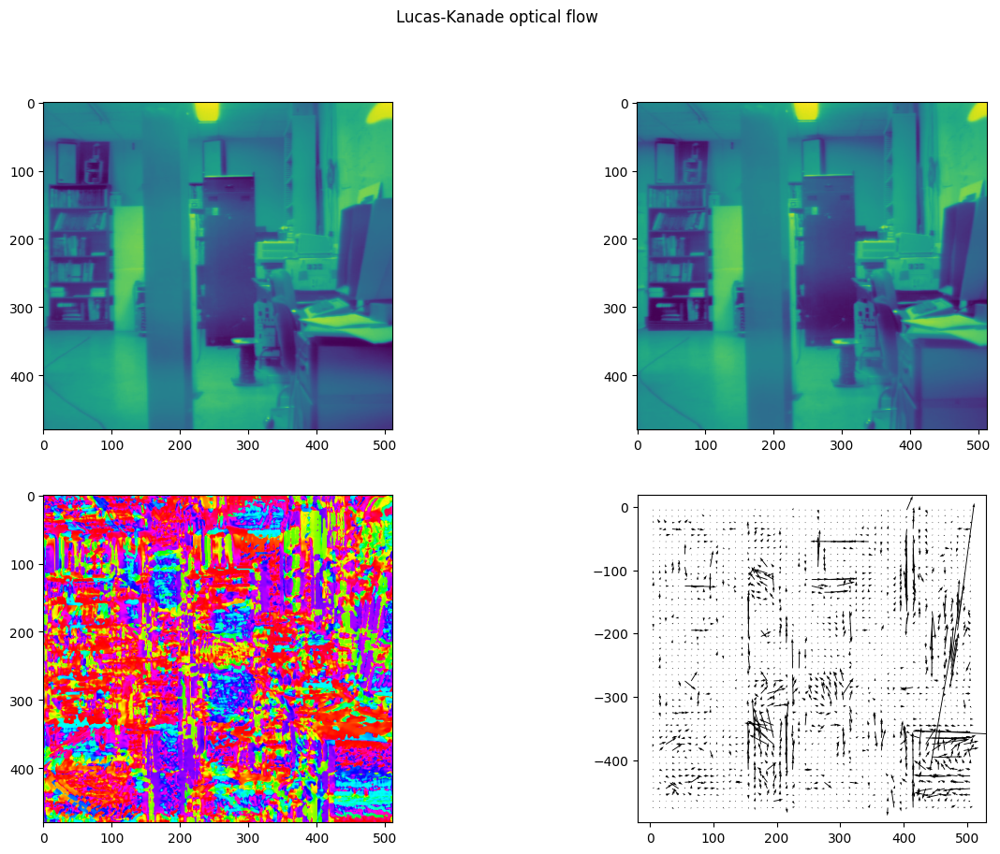

1579


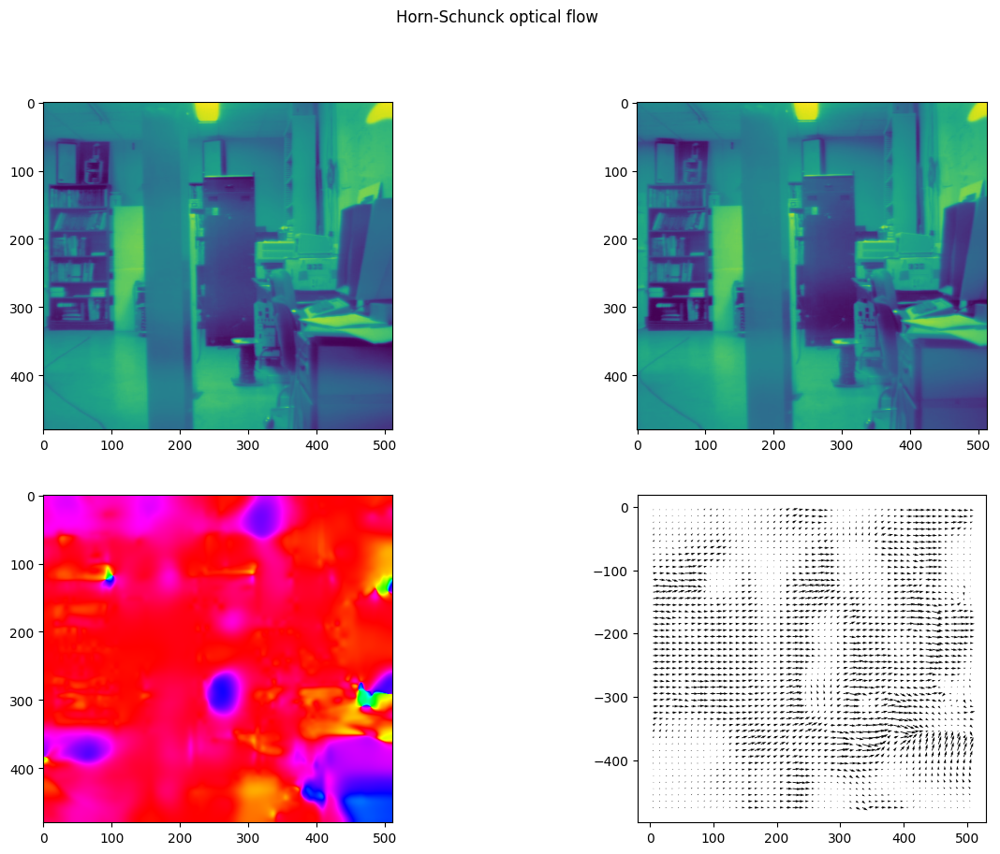

In [33]:
# Testing on other images
im1 = cv2.imread("disparity/office_left.png", cv2.IMREAD_GRAYSCALE)/255.0
im2 = cv2.imread("disparity/office_right.png",cv2.IMREAD_GRAYSCALE)/255.0
N = 3
sigma = im1.shape[0] / 200.0
lmbd = 0.5
convergence = 1e-7
subplot_field_lk(im1,im2, N, sigma, False, title="Lucas-Kanade optical flow")
subplot_field_hc(im1,im2, 10000, lmbd, sigma,convergence, "Horn-Schunck optical flow")

im1 = cv2.imread("disparity/cporta_left.png", cv2.IMREAD_GRAYSCALE)/255.0
im2 = cv2.imread("disparity/cporta_right.png", cv2.IMREAD_GRAYSCALE)/255.0
subplot_field_lk(im1,im2, N, sigma, False, title="Lucas-Kanade optical flow")
subplot_field_hc(im1,im2, 10000, lmbd, sigma,convergence, "Horn-Schunck optical flow")

im1 = cv2.imread("disparity/office2_left.png", cv2.IMREAD_GRAYSCALE)/255.0
im2 = cv2.imread("disparity/office2_right.png", cv2.IMREAD_GRAYSCALE)/255.0
subplot_field_lk(im1,im2, N, sigma, False, title="Lucas-Kanade optical flow")
subplot_field_hc(im1,im2, 10000, lmbd, sigma,convergence, "Horn-Schunck optical flow")

im1 = cv2.imread("collision/00000181.jpg", cv2.IMREAD_GRAYSCALE)/255.0
im2 = cv2.imread("collision/00000182.jpg", cv2.IMREAD_GRAYSCALE)/255.0
subplot_field_lk(im1,im2, N, sigma, False, title="Lucas-Kanade optical flow")
subplot_field_hc(im1,im2, 10000, lmbd, sigma,convergence, "Horn-Schunck optical flow")

im1 = cv2.imread("lab2/001.jpg", cv2.IMREAD_GRAYSCALE)/255.0
im2 = cv2.imread("lab2/002.jpg", cv2.IMREAD_GRAYSCALE)/255.0
subplot_field_lk(im1,im2, N, sigma, False, title="Lucas-Kanade optical flow")
subplot_field_hc(im1,im2, 10000, lmbd, sigma,convergence, "Horn-Schunck optical flow")

## Harris addition for lukas kanade

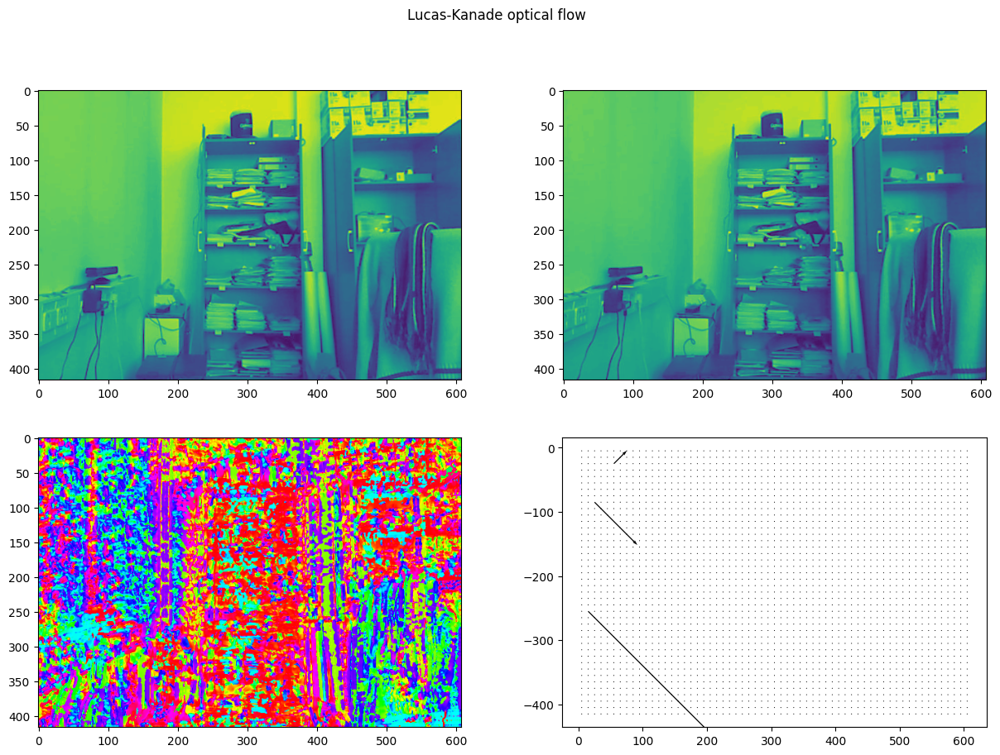

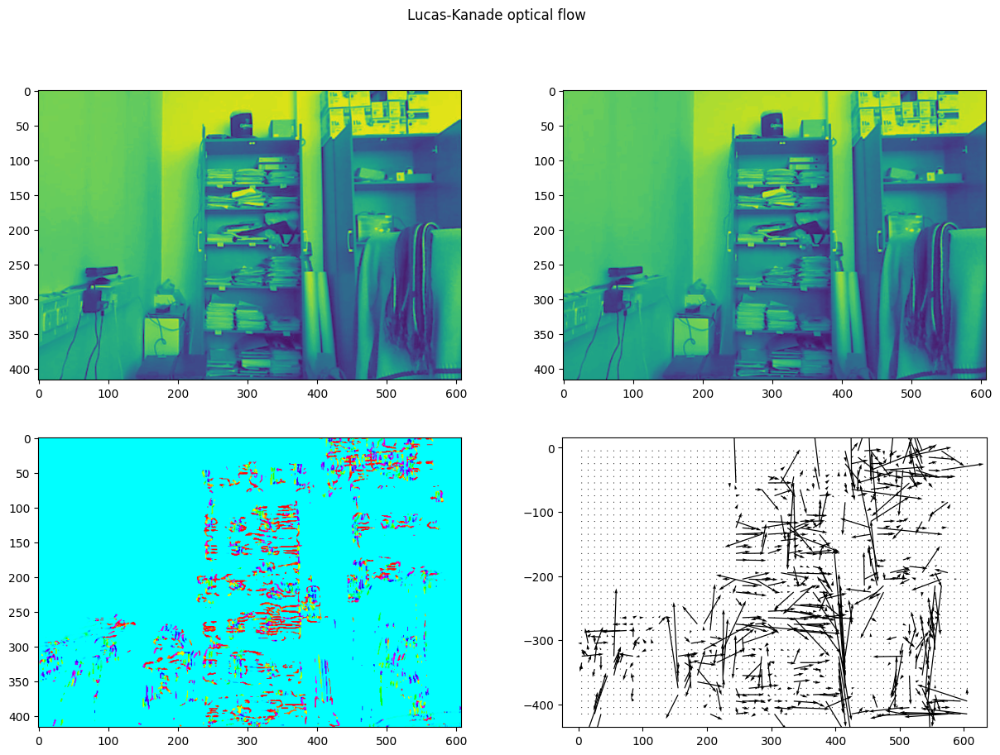

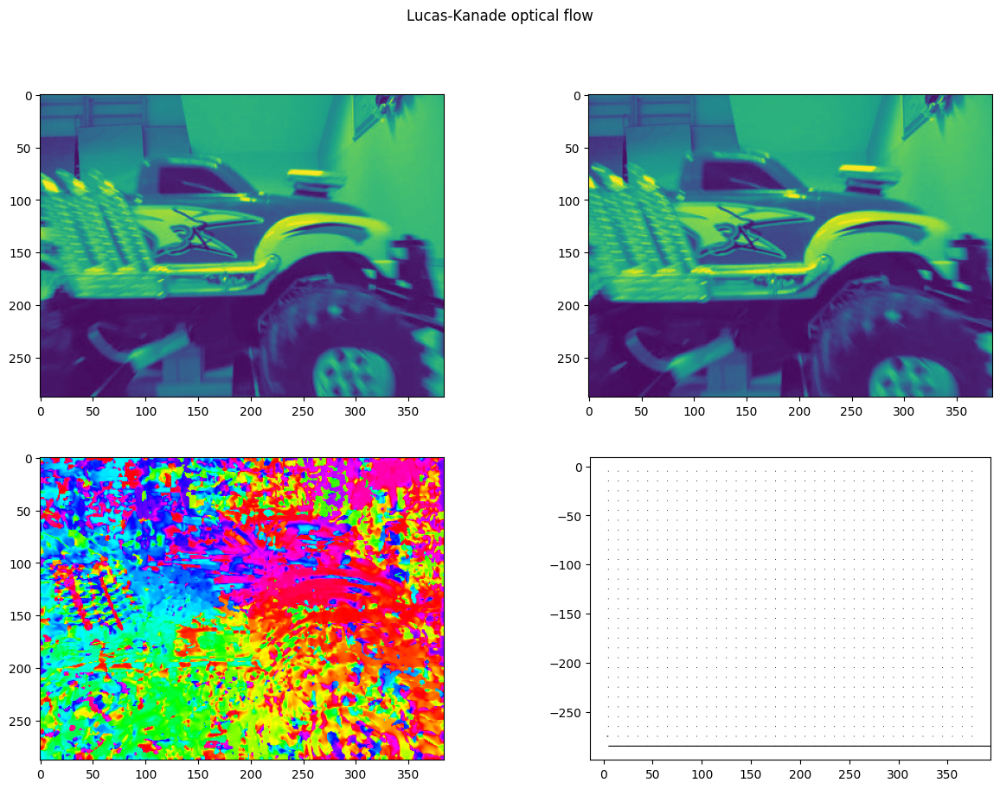

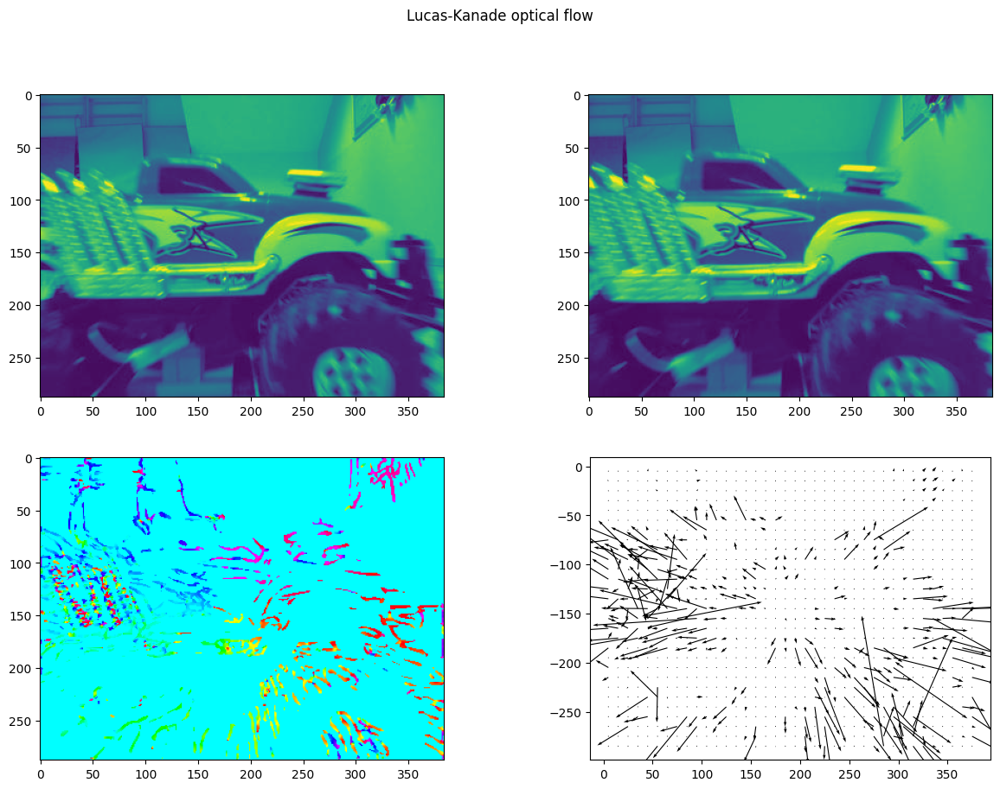

In [32]:
# Testing on other images
im1 = cv2.imread("disparity/office2_left.png", cv2.IMREAD_GRAYSCALE)/255.0
im2 = cv2.imread("disparity/office2_right.png",cv2.IMREAD_GRAYSCALE)/255.0
N = 3
sigma = im1.shape[0] / 200.0
lmbd = 0.5
subplot_field_lk(im1,im2, N, sigma, False, title="Lucas-Kanade optical flow")
subplot_field_lk(im1,im2, N, sigma, True, title="Lucas-Kanade optical flow")

im1 = cv2.imread("collision/00000181.jpg", cv2.IMREAD_GRAYSCALE)/255.0
im2 = cv2.imread("collision/00000182.jpg", cv2.IMREAD_GRAYSCALE)/255.0
subplot_field_lk(im1,im2, N, sigma, False, title="Lucas-Kanade optical flow")
subplot_field_lk(im1,im2, N, sigma, True, title="Lucas-Kanade optical flow")

## Determining parameters

3 1


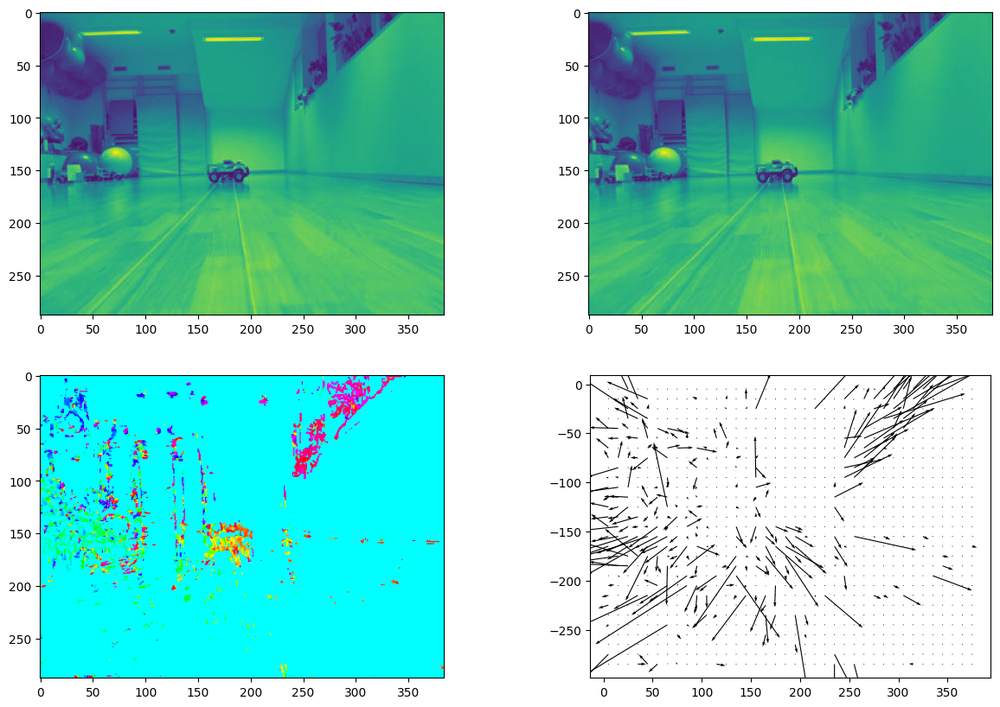

9 1


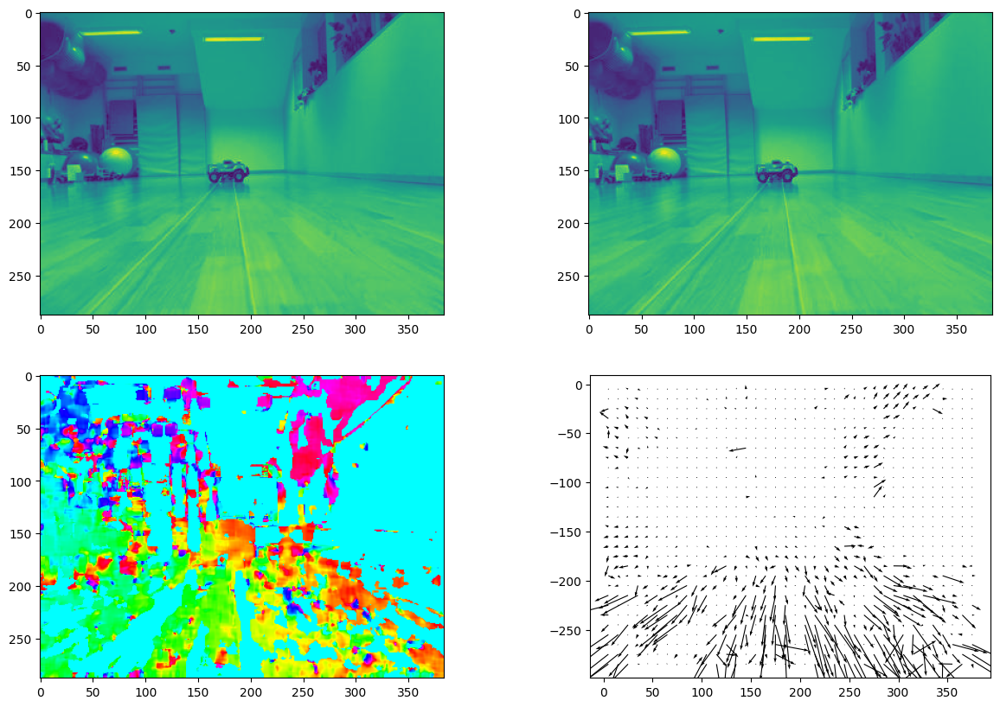

15 1


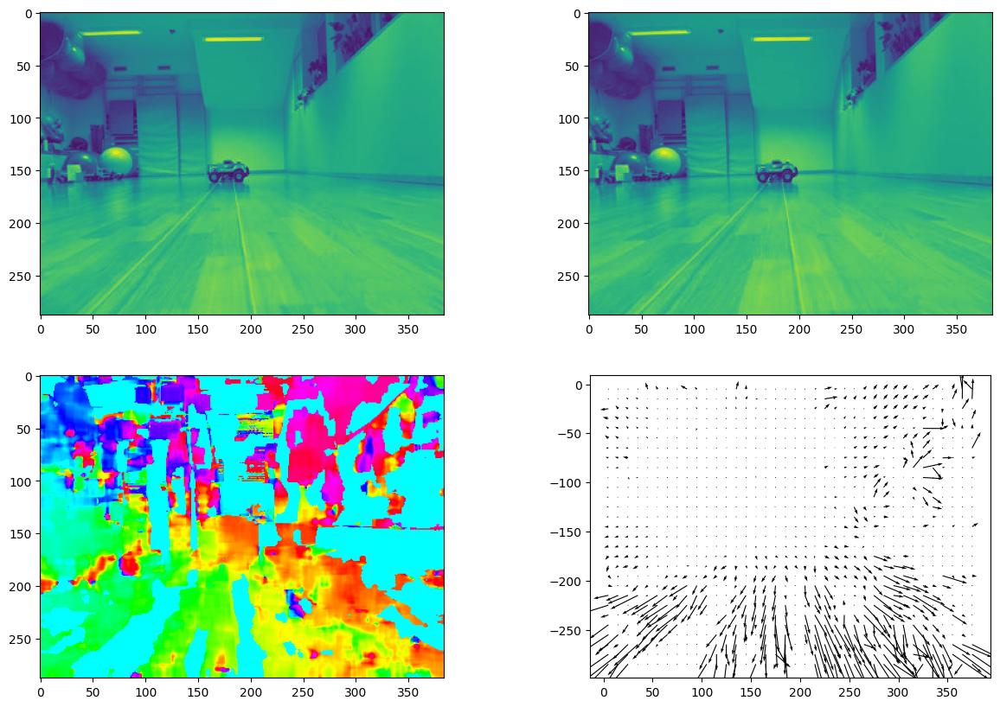

35 1


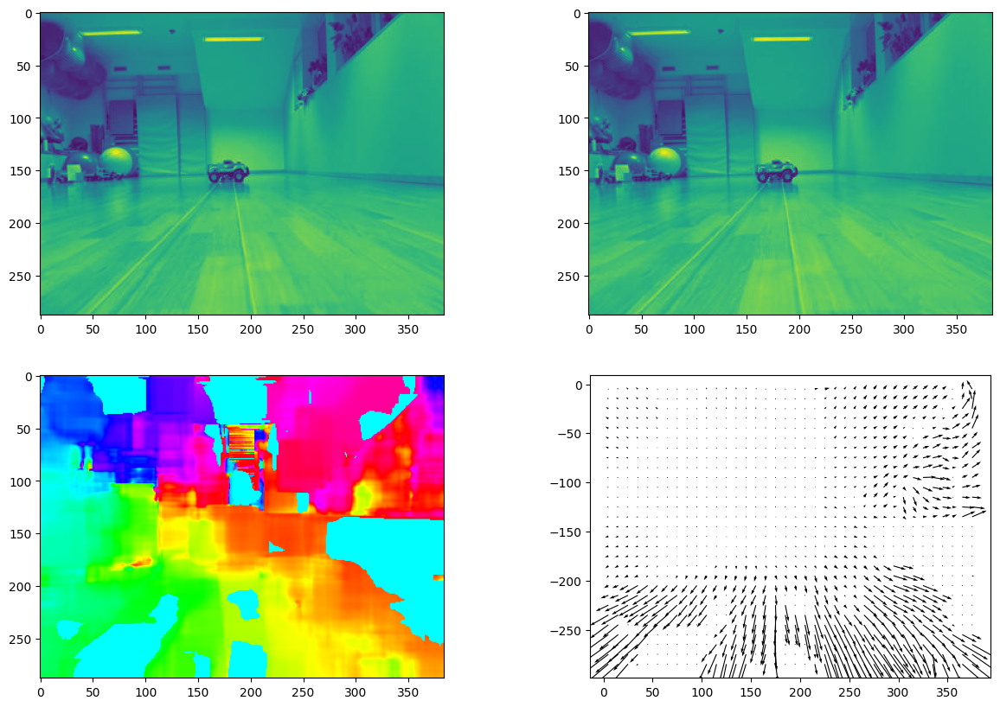

50 1


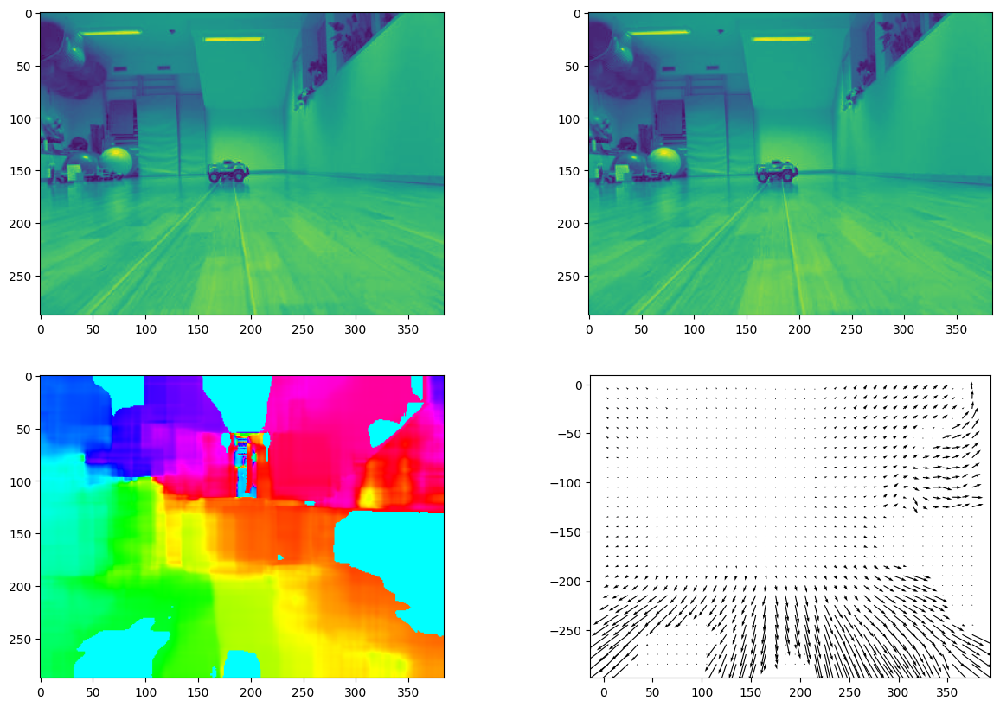

100 1


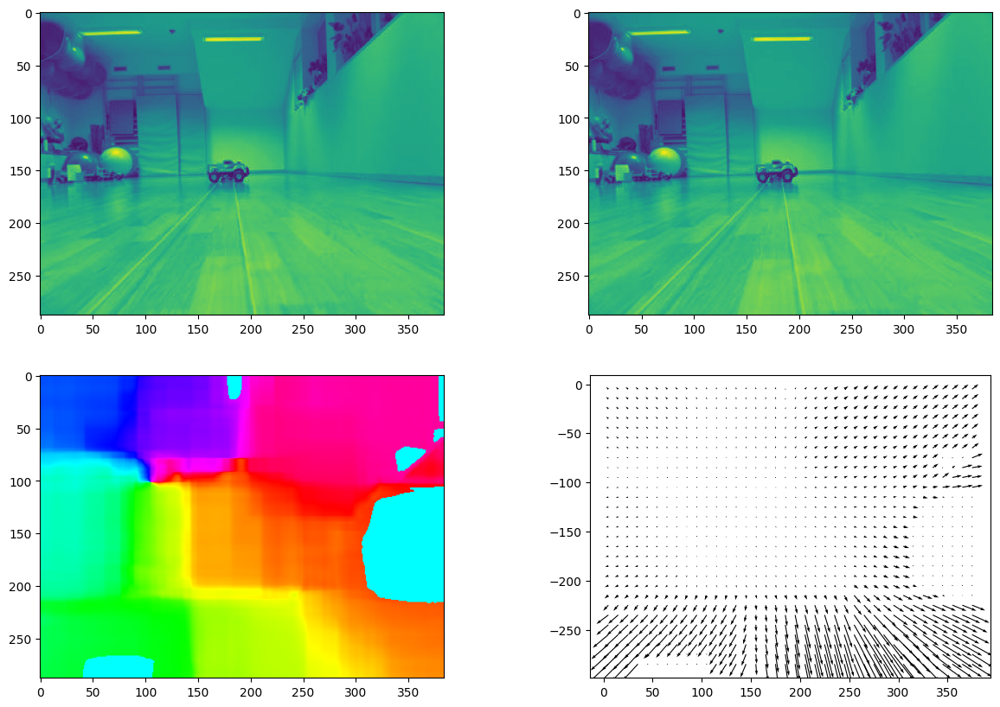

3 1


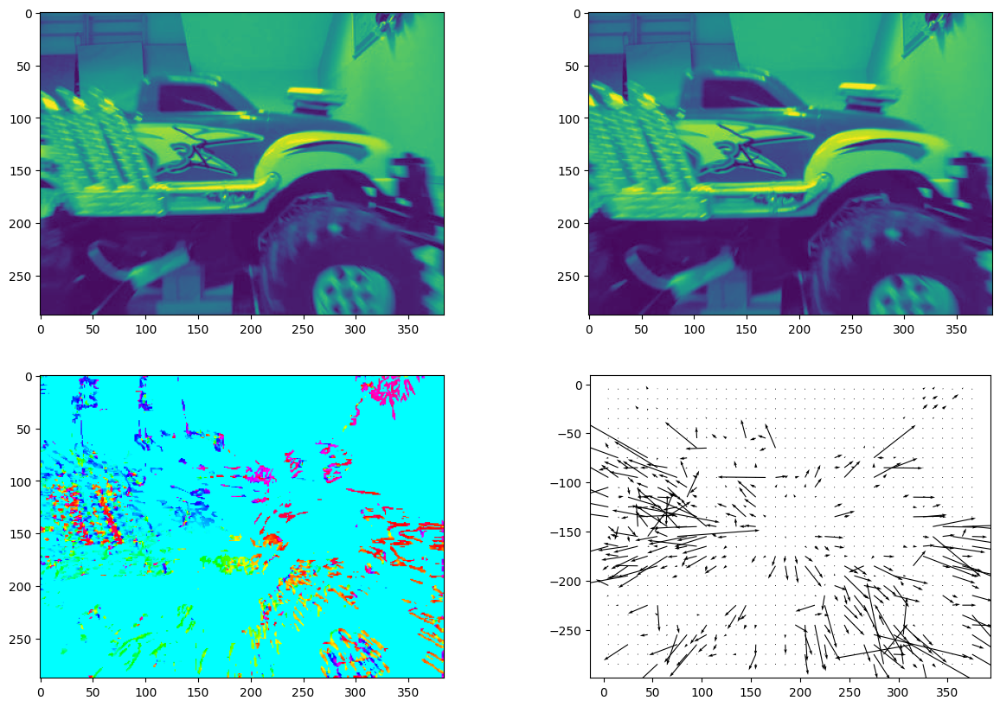

9 1


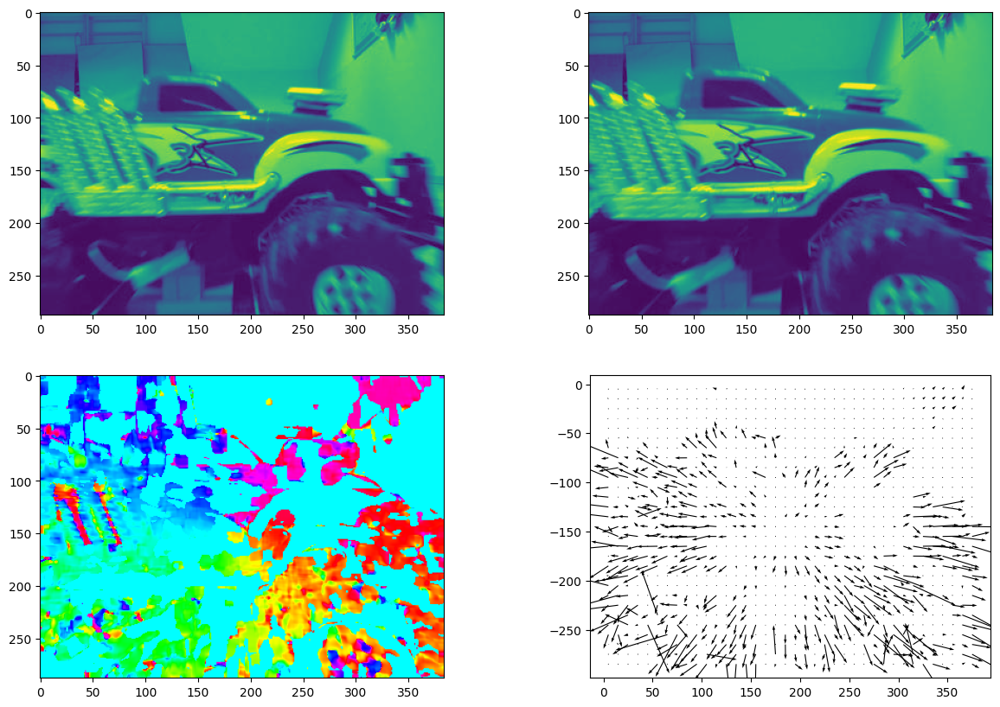

15 1


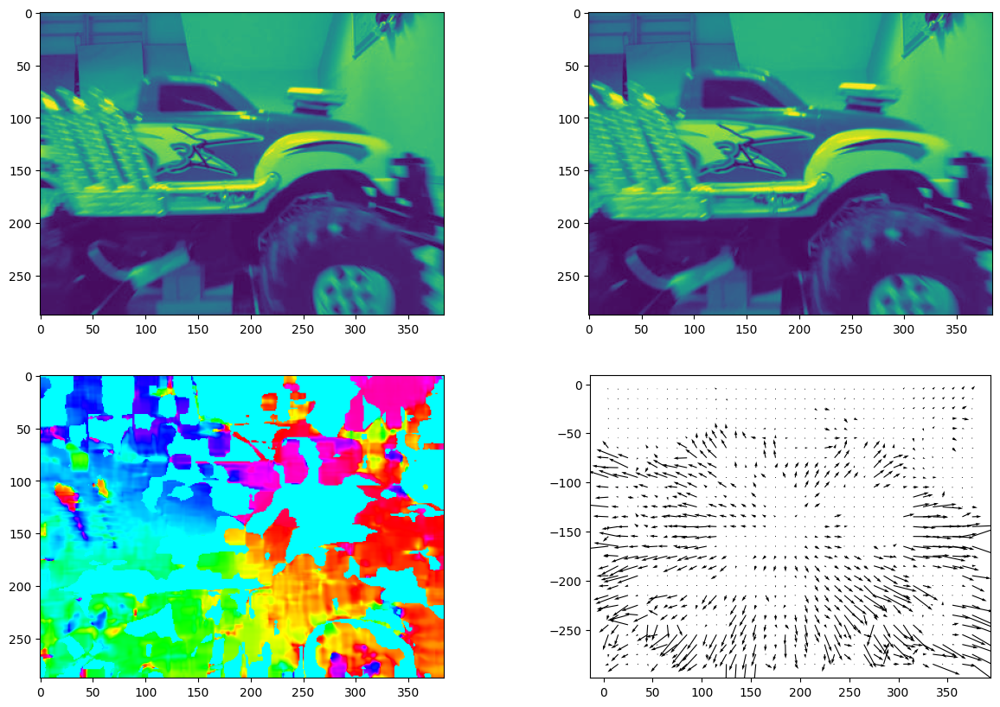

35 1


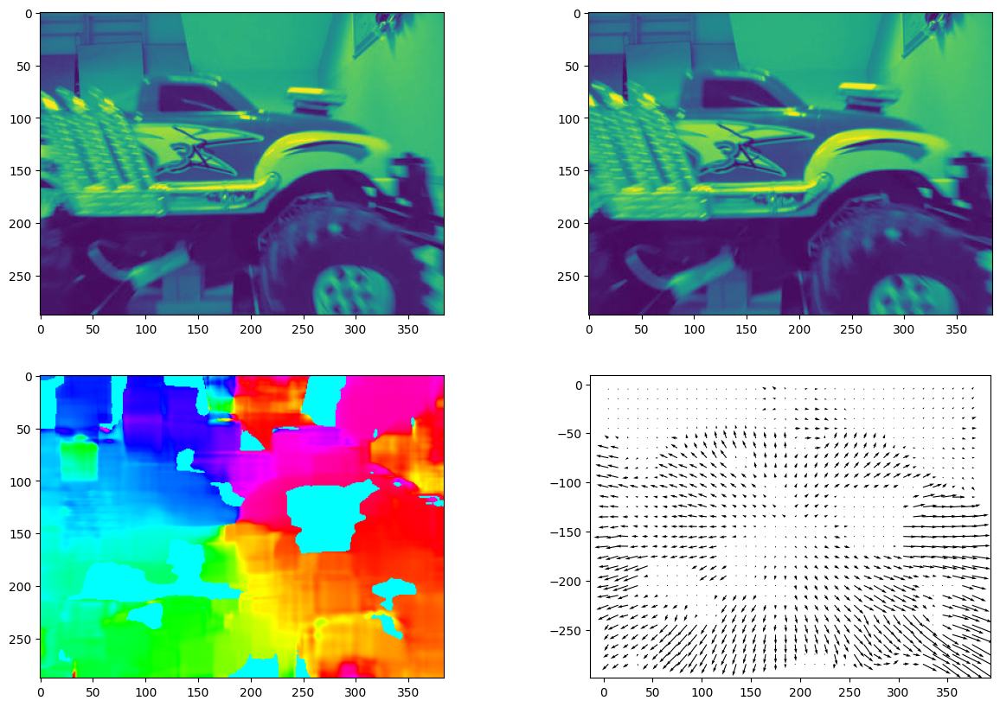

50 1


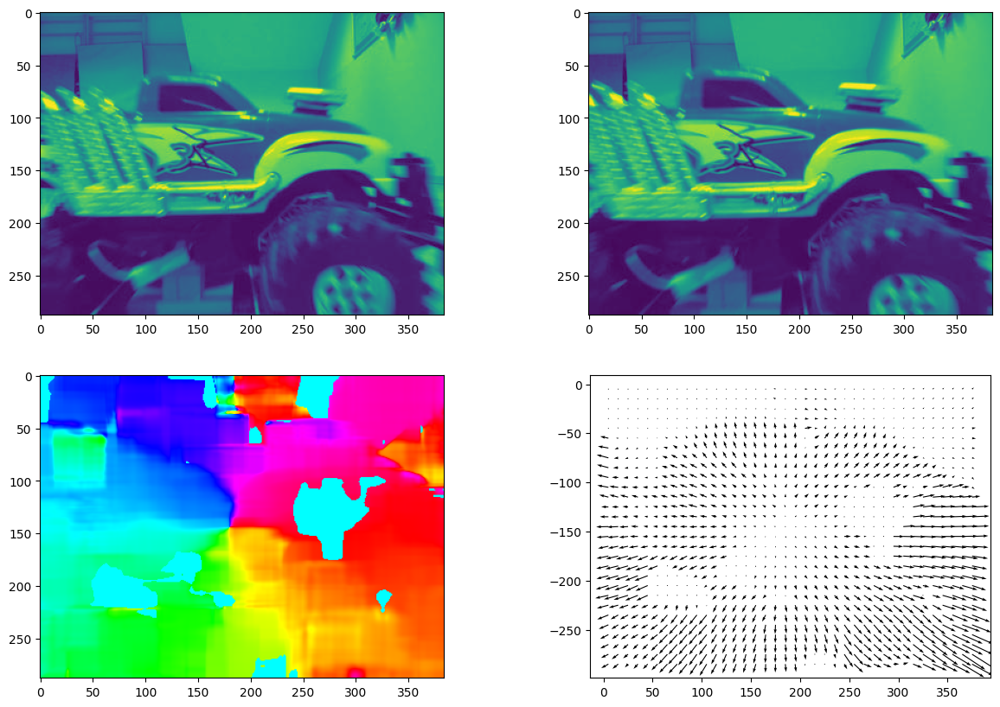

100 1


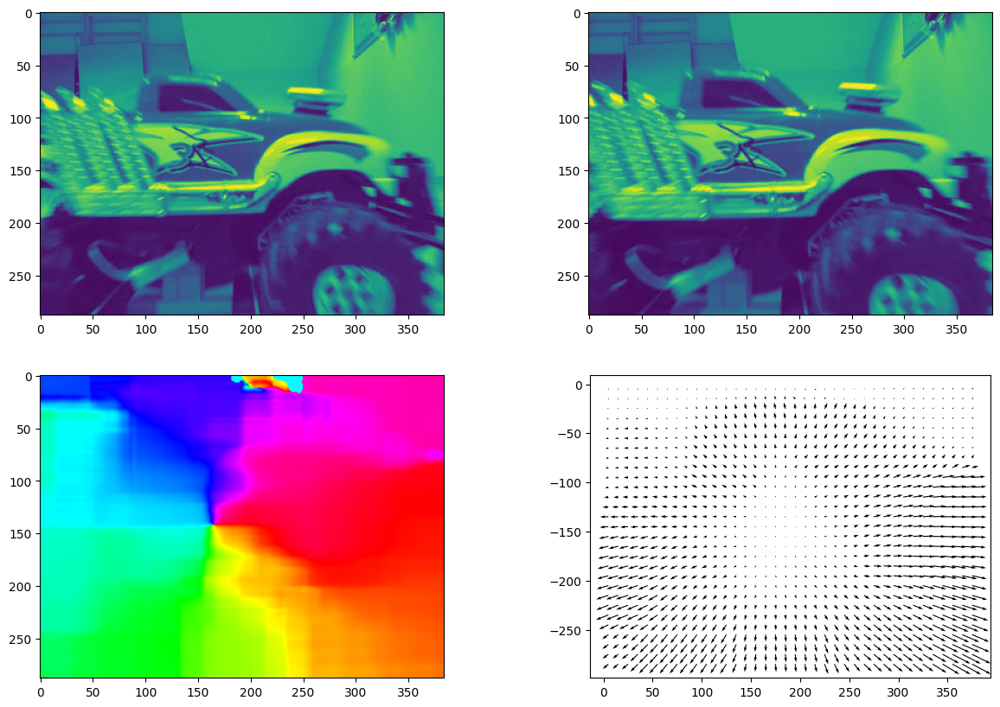

In [40]:
# LUKAS KANADE, We can determine N, HIGHER RES LARGER NEIGHBOURHOOD, larger neighbourhood - less noisy, however we cant get as detailed 
# This car example is nice
sigma = int(im1.shape[0] /200)
im1 = cv2.imread("collision/00000001.jpg", cv2.IMREAD_GRAYSCALE)/255.0
im2 = cv2.imread("collision/00000002.jpg", cv2.IMREAD_GRAYSCALE)/255.0


for N in (3,9,15,35, 50, 100):
    print(N, sigma)
    subplot_field_lk(im1,im2, N=N, harris=True, sigma=sigma)


im1 = cv2.imread("collision/00000181.jpg", cv2.IMREAD_GRAYSCALE)/255.0
im2 = cv2.imread("collision/00000182.jpg", cv2.IMREAD_GRAYSCALE)/255.0

for N in (3,9,15,35, 50, 100):
    print(N, sigma)
    subplot_field_lk(im1,im2, N=N, harris=True, sigma=sigma)

0.001
999


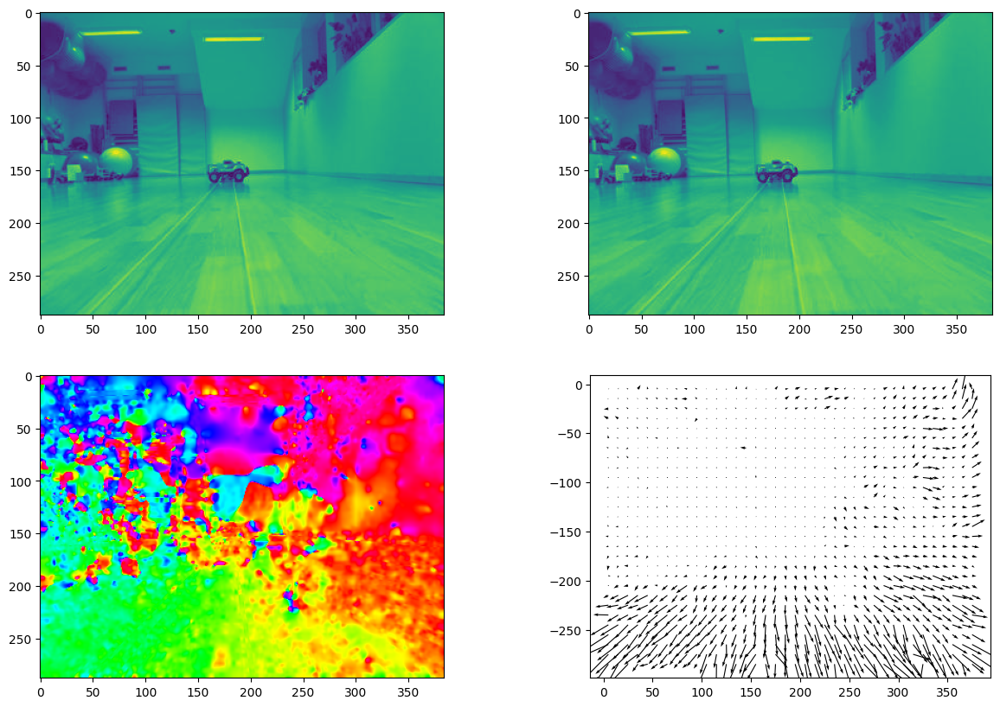

0.01
999


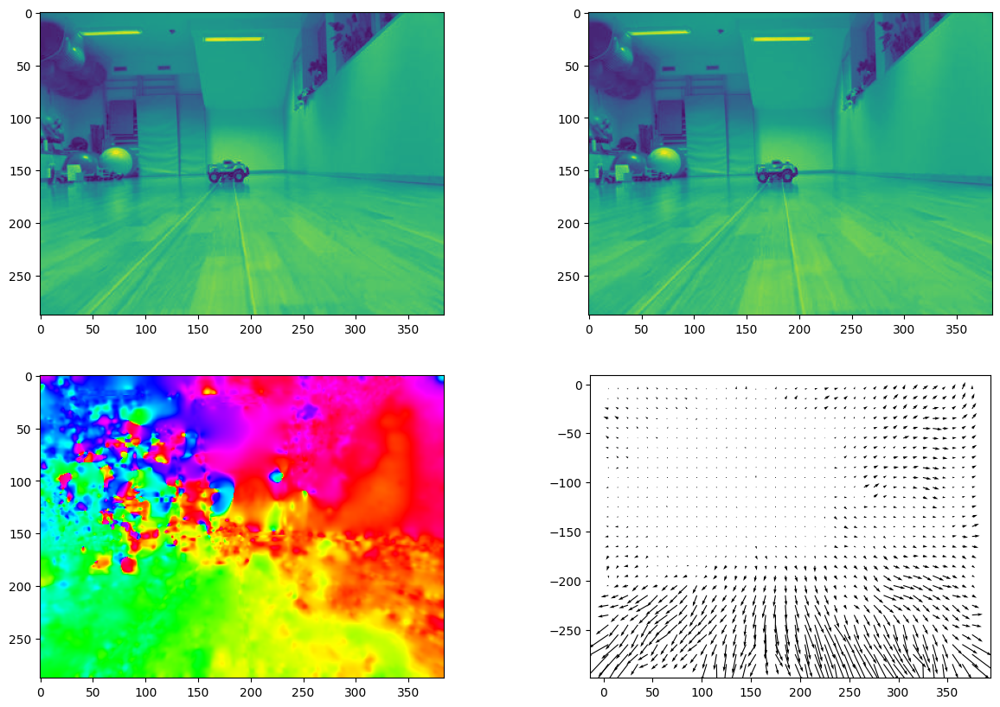

0.1
999


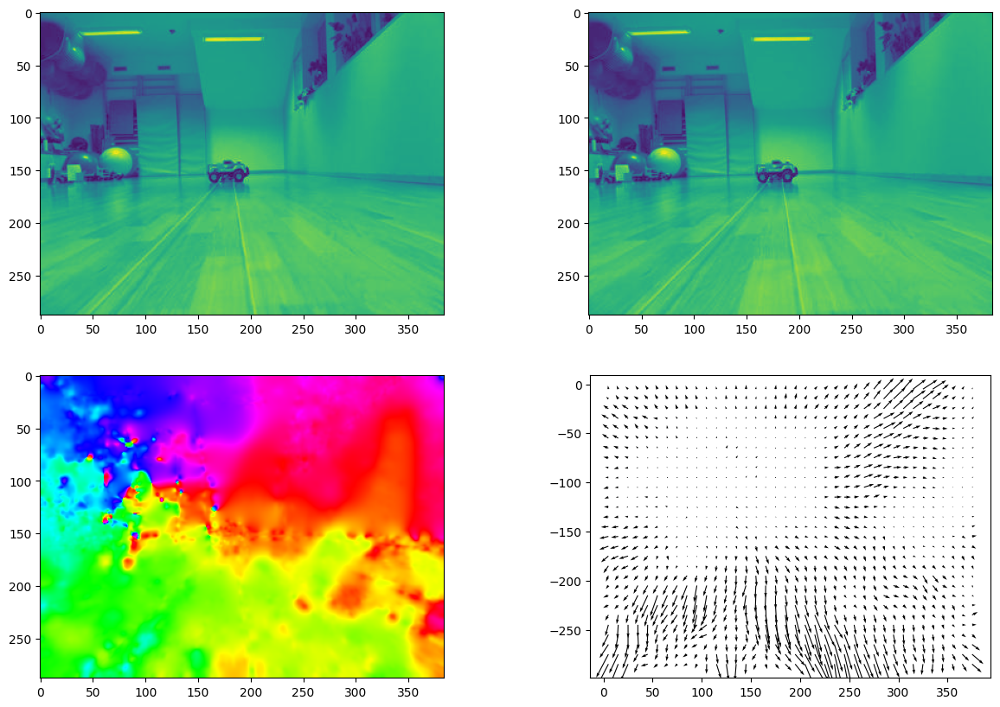

1
999


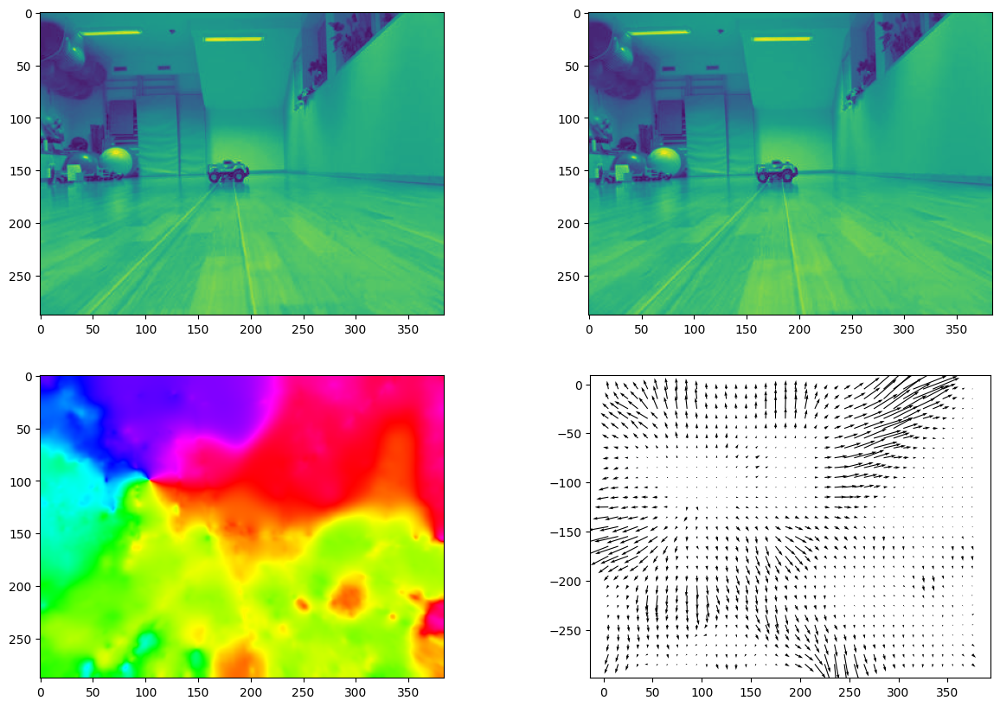

10
999


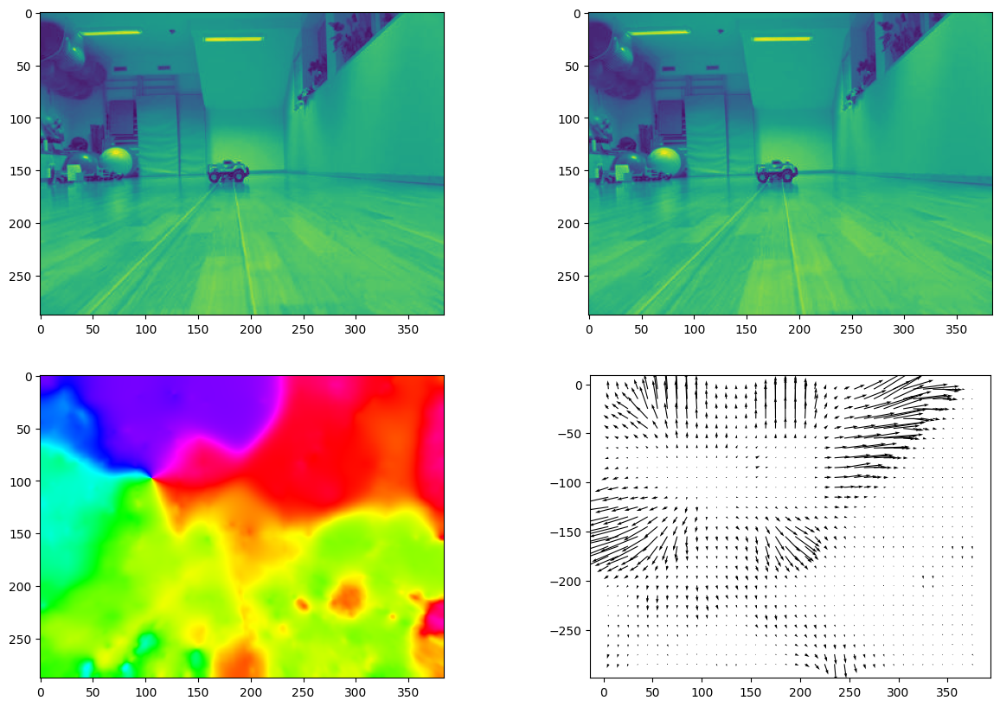

100
999


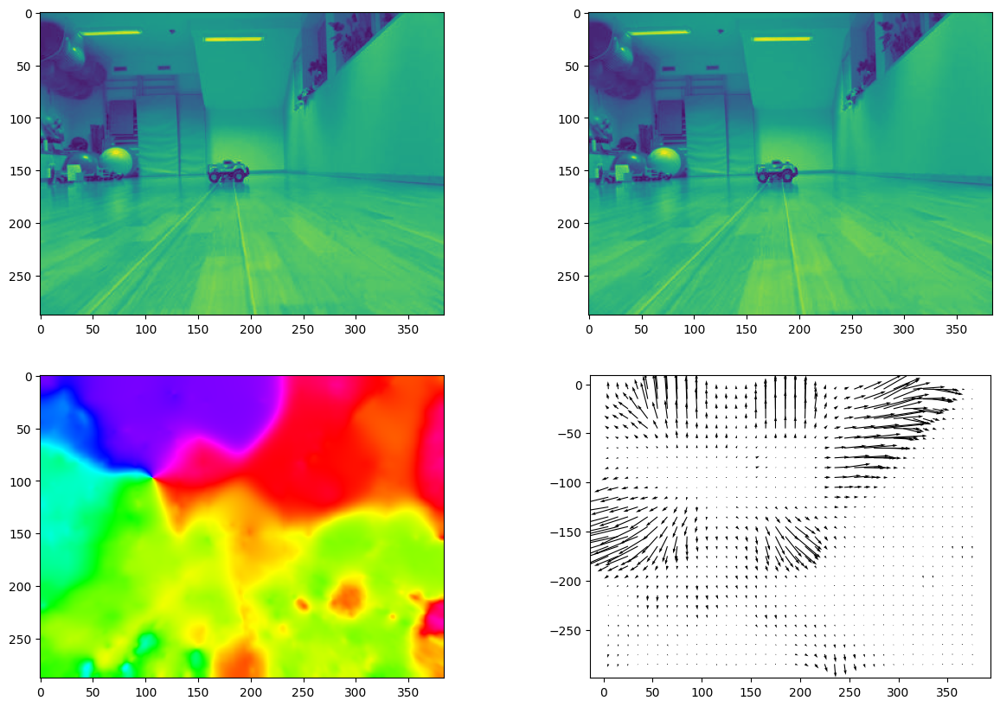

1000
999


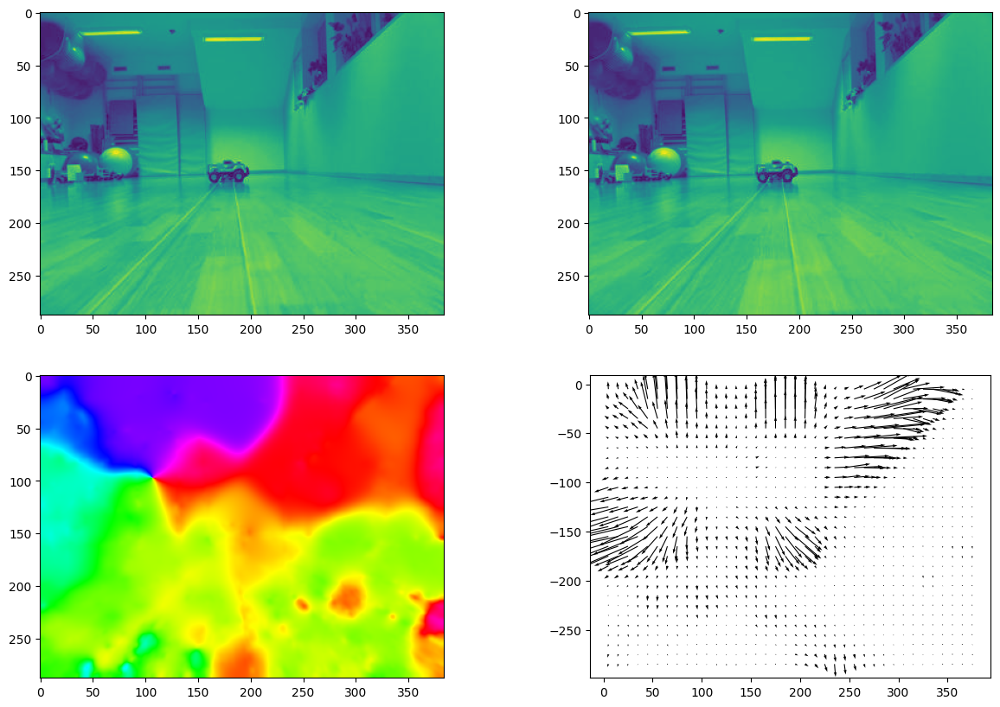

0.001
999


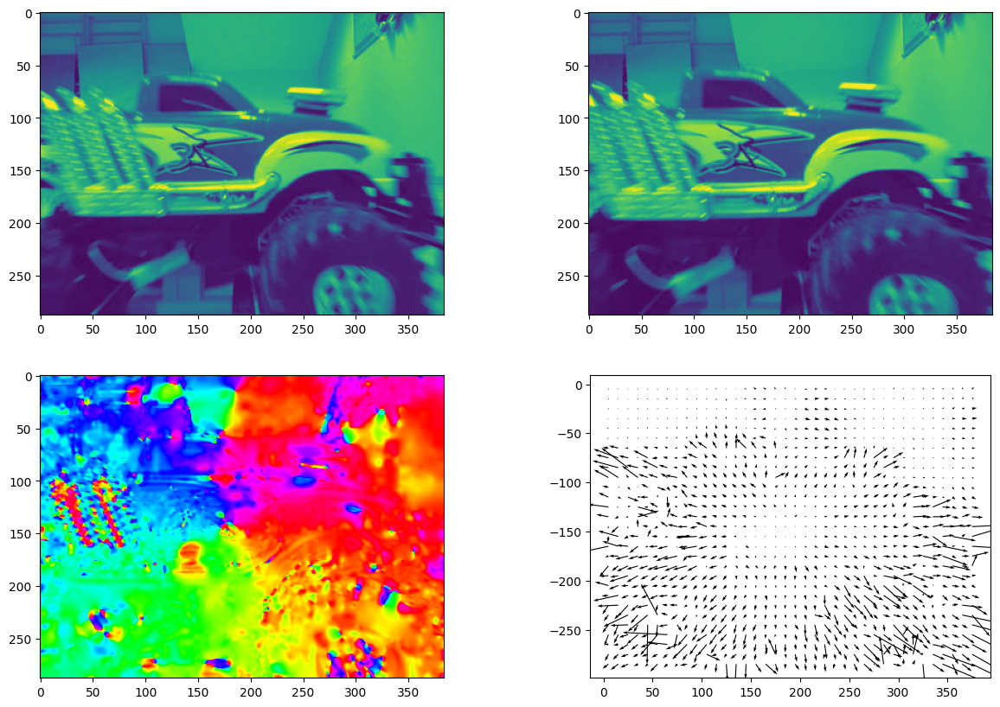

0.01
999


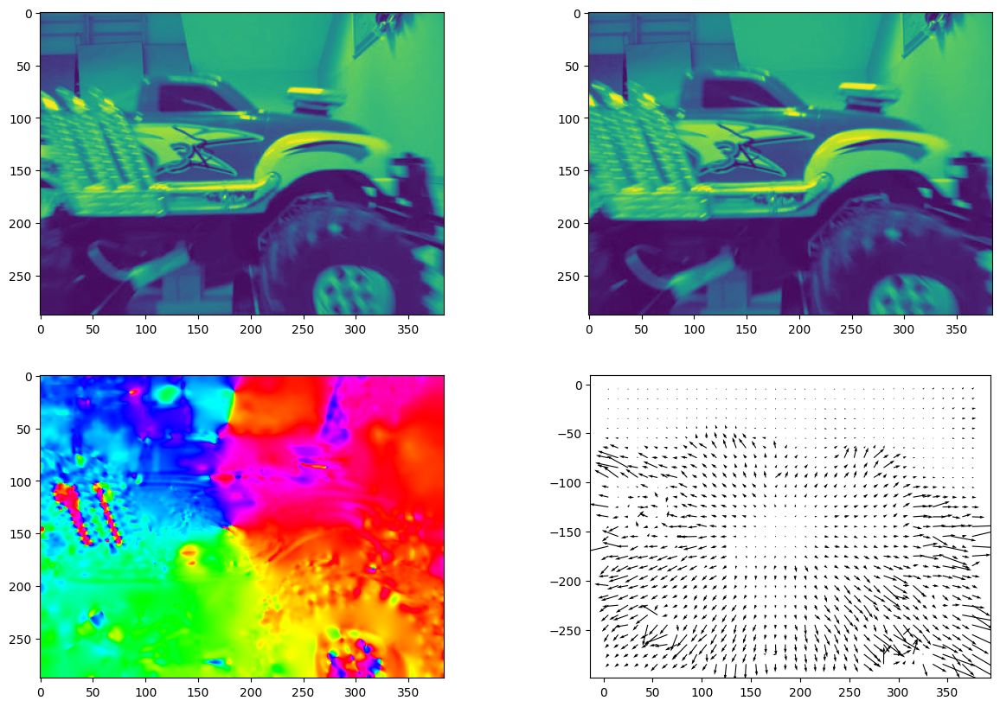

0.1
999


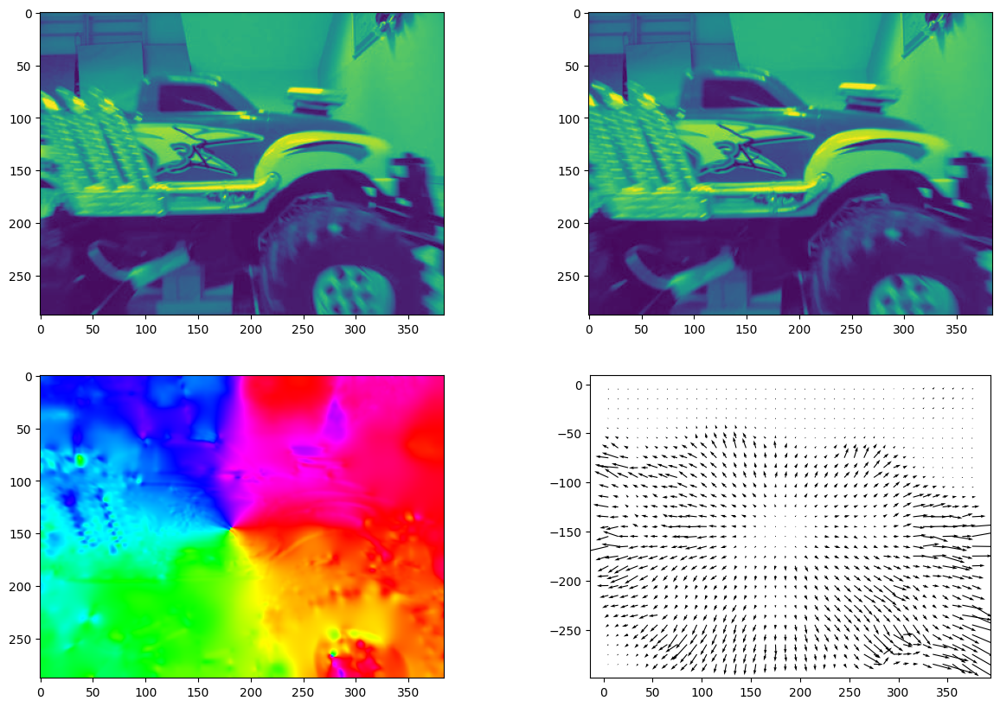

1
999


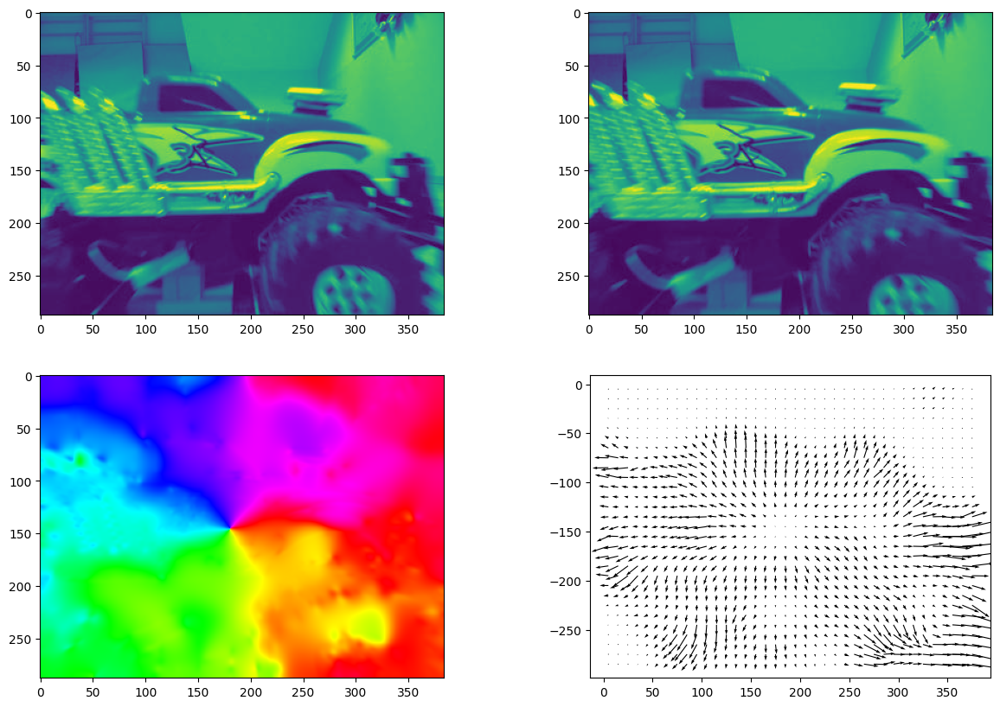

10
999


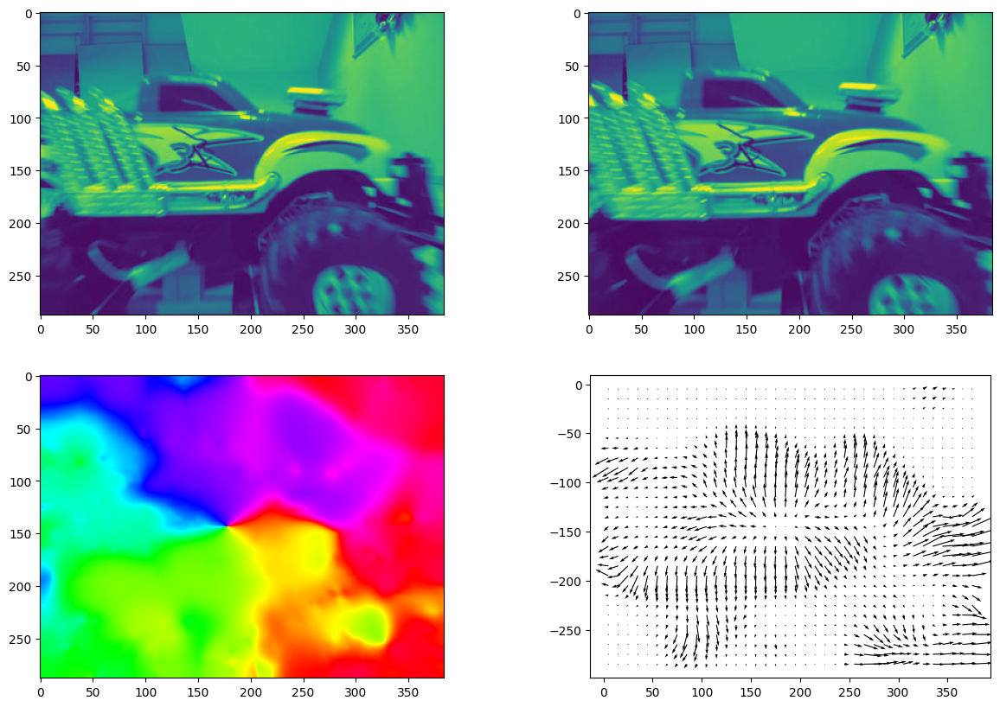

100
999


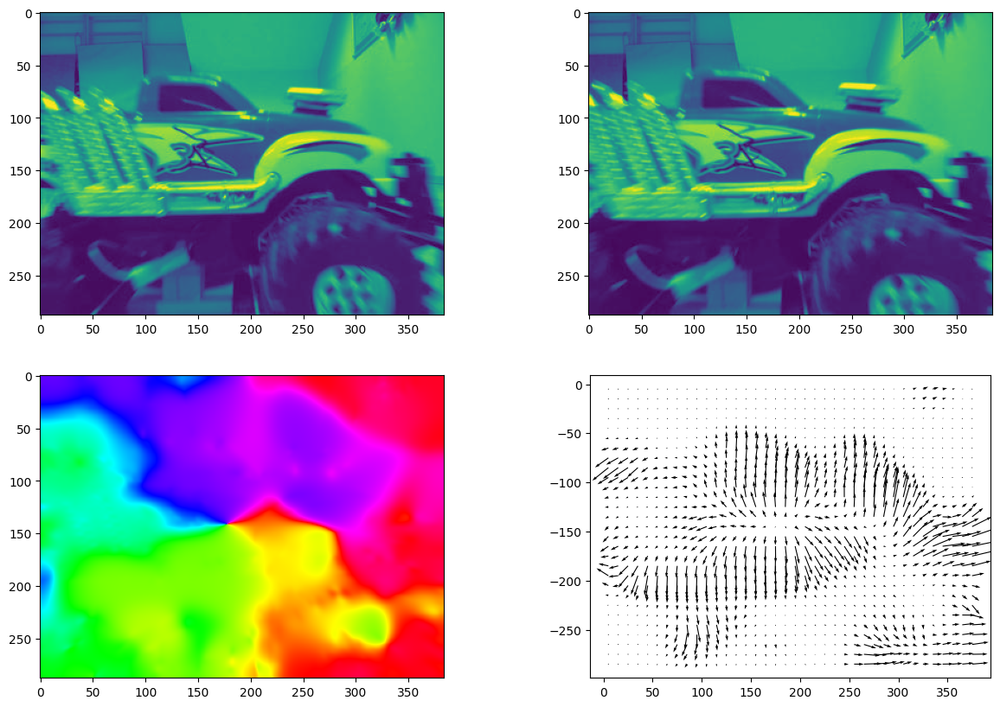

1000
999


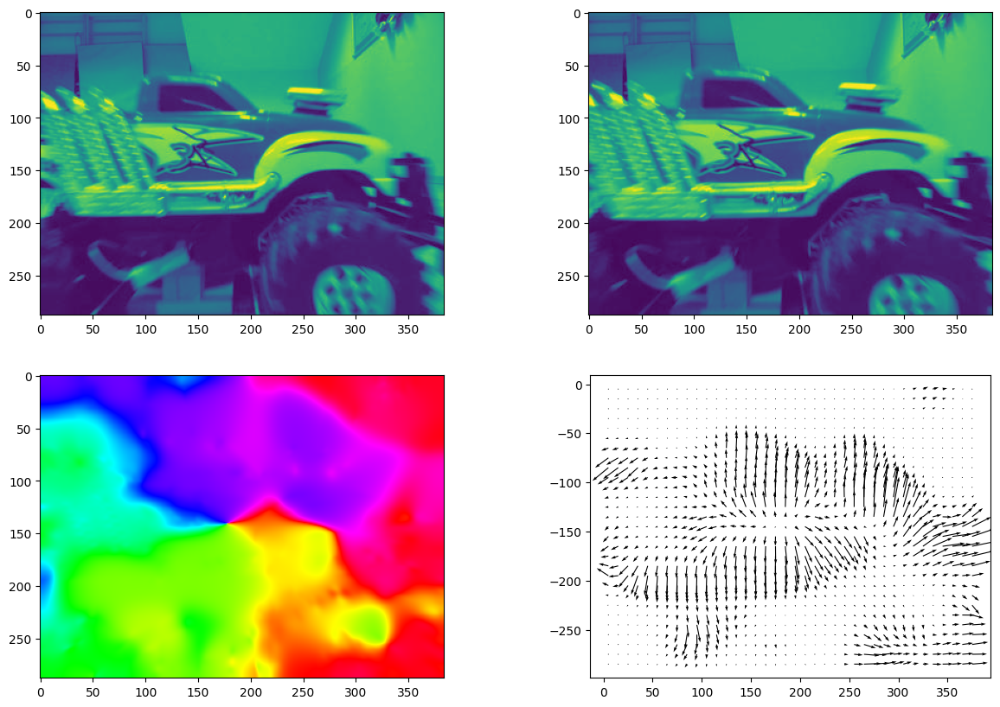

In [310]:
# hornschnuck, we can look at lambda
# n_iters could also be looked at but it is better to keep that as a last resort if it wouldnt converge
# lamda is determines how much we care about the flow smoothnes 
sigma = int(im1.shape[0] /200)
im1 = cv2.imread("collision/00000001.jpg", cv2.IMREAD_GRAYSCALE)/255.0
im2 = cv2.imread("collision/00000002.jpg", cv2.IMREAD_GRAYSCALE)/255.0
#convergence = 1e-8

for lmbd in (0.001,0.01, 0.1, 1, 10,100,1000):
    print(lmbd)
    subplot_field_hc(im1,im2, n_iters = 1000, lmbd=lmbd, sigma=sigma, convergence_tresh=-1)


im1 = cv2.imread("collision/00000181.jpg", cv2.IMREAD_GRAYSCALE)/255.0
im2 = cv2.imread("collision/00000182.jpg", cv2.IMREAD_GRAYSCALE)/255.0

for lmbd in (0.001,0.01, 0.1, 1, 10,100,1000):
    print(lmbd)
    subplot_field_hc(im1,im2, n_iters = 1000, lmbd=lmbd, sigma=sigma, convergence_tresh=-1)


## Time measurements

In [52]:
# write what kind of parameters you used
sigma = int(im1.shape[0] /200)
im1a = cv2.imread("lab2/007.jpg", cv2.IMREAD_GRAYSCALE)/255.0
im2a = cv2.imread("lab2/008.jpg",cv2.IMREAD_GRAYSCALE)/255.0

im1b = cv2.imread("collision/00000181.jpg", cv2.IMREAD_GRAYSCALE)/255.0
im2b = cv2.imread("collision/00000182.jpg", cv2.IMREAD_GRAYSCALE)/255.0

im1c = cv2.imread("disparity/cporta_right.png", cv2.IMREAD_GRAYSCALE)/255.0
im2c = cv2.imread("disparity/cporta_left.png", cv2.IMREAD_GRAYSCALE)/255.0

# Lukas kanade time measurement
N  = 50
start_lk = timer()
lucaskanade(im1a,im2a, N, sigma)
lucaskanade(im1b,im2b, N, sigma)
lucaskanade(im1c,im2c, N, sigma)
stop_lk = timer()
print(f"Average time for the lukas kanade optical flow method: {(stop_lk-start_lk)/3} seconds")


# Horn-Schnuck 
lmbd = 0.5
n_iters = 10000
convergence = 1e-7
start_hs = timer()
hornschunck(im1a,im2a,n_iters, lmbd, sigma, convergence)
hornschunck(im1b,im2b,n_iters, lmbd, sigma, convergence)
hornschunck(im1c,im2c,n_iters, lmbd, sigma, convergence)
stop_hs = timer()
print(f"Average time for the Horn-schnuck optical flow method: {(stop_hs-start_hs)/3} seconds")


Average time for the lukas kanade optical flow method: 0.05077396666577746 seconds
1524
1243
521
Average time for the Horn-schnuck optical flow method: 7.03858650000014 seconds


### Using lukas kanade as input for Horn-Schnuck

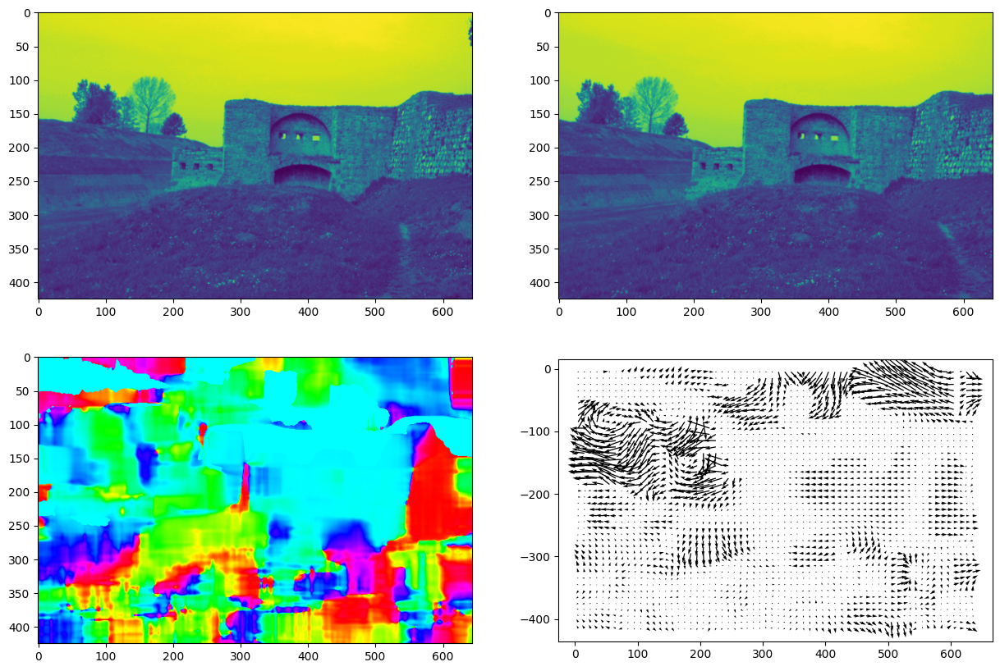

514


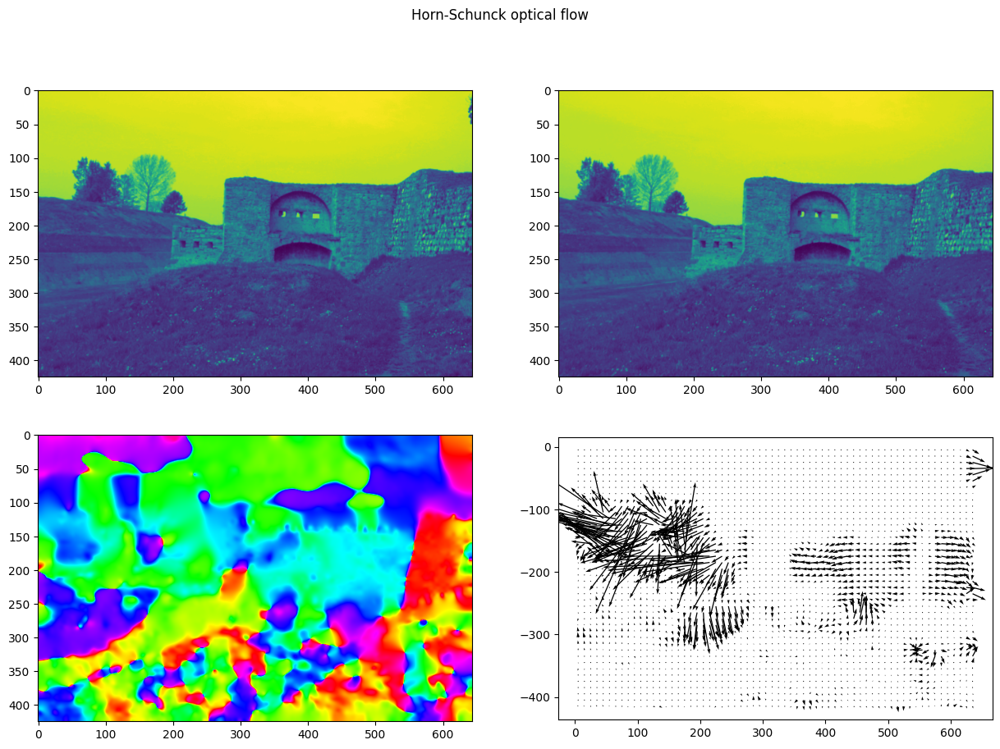

371


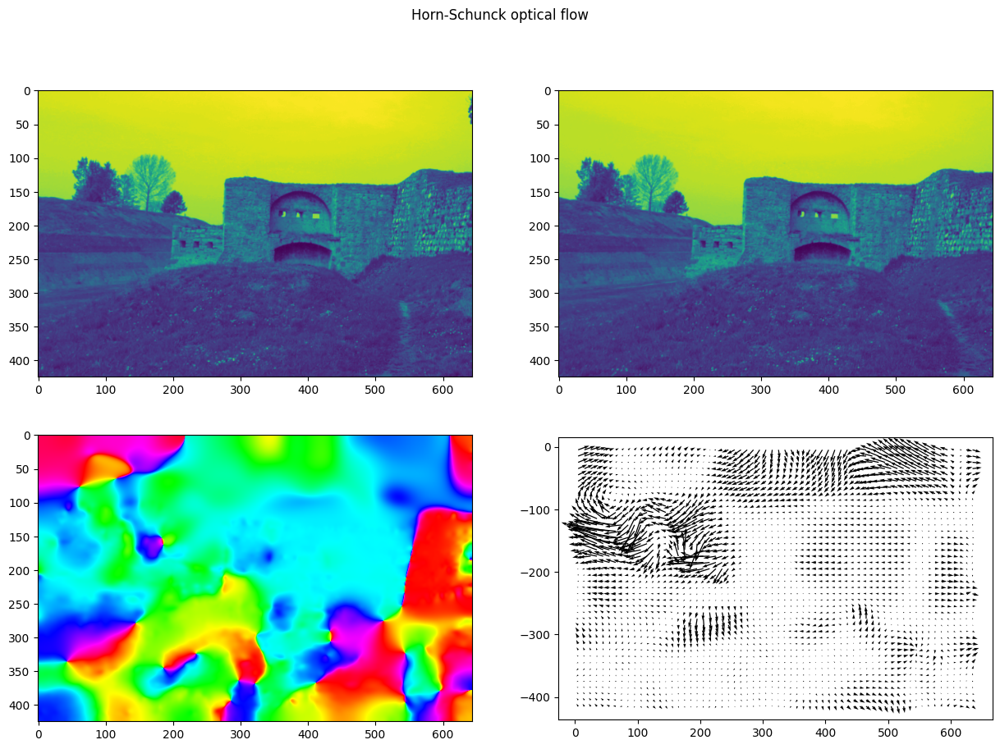

1097
313
370
Average time for the Horn-schnuck with LK input optical flow method: 4.8963933999997 seconds


In [53]:
# Example
im1 = cv2.imread("disparity/cporta_right.png", cv2.IMREAD_GRAYSCALE)/255.0
im2 = cv2.imread("disparity/cporta_left.png", cv2.IMREAD_GRAYSCALE)/255.0

N = 50
sigma = im1.shape[0] / 200.0
lmbd = 0.5
convergence = 1e-7
subplot_field_lk(im1,im2,N,sigma, True)
subplot_field_hc(im1,im2, 2000, lmbd, sigma,convergence, "Horn-Schunck optical flow")
u_lk, v_lk = lucaskanade(im1, im2, N, sigma, False)
subplot_field_hc(im1,im2, 2000, lmbd, sigma,convergence, "Horn-Schunck optical flow", u_start = u_lk, v_start=v_lk)

# Time it
sigma = int(im1.shape[0] /200)
im1a = cv2.imread("lab2/007.jpg", cv2.IMREAD_GRAYSCALE)/255.0
im2a = cv2.imread("lab2/008.jpg",cv2.IMREAD_GRAYSCALE)/255.0

im1b = cv2.imread("collision/00000181.jpg", cv2.IMREAD_GRAYSCALE)/255.0
im2b = cv2.imread("collision/00000182.jpg", cv2.IMREAD_GRAYSCALE)/255.0

im1c = cv2.imread("disparity/cporta_right.png", cv2.IMREAD_GRAYSCALE)/255.0
im2c = cv2.imread("disparity/cporta_left.png", cv2.IMREAD_GRAYSCALE)/255.0

start = timer()
u_lk, v_lk = lucaskanade(im1a,im2a, N, sigma)
hornschunck(im1a,im2a,2000, lmbd, sigma,convergence, start_u = u_lk,start_v=v_lk)
u_lk, v_lk = lucaskanade(im1b,im2b, N, sigma)
hornschunck(im1b,im2b,2000, lmbd, sigma,convergence, start_u  = u_lk, start_v=v_lk)
u_lk, v_lk = lucaskanade(im1c,im2c, N, sigma)
hornschunck(im1c,im2c,2000, lmbd, sigma,convergence, start_u  = u_lk, start_v=v_lk)
stop = timer()
print(f"Average time for the Horn-schnuck with LK input optical flow method: {(stop-start)/3} seconds")


## Implementing the pyramidial structure

In [255]:
def subplot_field_lk_pyramid(im1, im2, N, sigma, title=""):
    fig1, ax = plt.subplots(2, 2, figsize=(15, 10))

    ax1_11, ax1_12 = ax[0]
    ax1_21, ax1_22 = ax[1]

    ax1_11.imshow(im1)
    ax1_12.imshow(im2)

    U, V = pyramidial_lucaskanade(im1,im2, N, sigma)
    show_flow(U, V, ax1_21, type="angle")
    show_flow(U, V, ax1_22, type="field", set_aspect=True)

    fig1.suptitle(title)
    
    plt.show()

In [303]:
def warp_with_flow_field(image, u, v):
    """Function for inverse warping images with the given flow u, v"""
    # Get coordinate matrices
    h, w = image.shape

    x,y = np.meshgrid(np.arange(w), np.arange(h))


    # Add the flow field to the coordinate matrices, to tell cv2 where to map the pixels
    map_x = (x - u).astype(np.float32)
    map_y = (y - v).astype(np.float32)
    warped = cv2.remap(image, map_x, map_y, interpolation=cv2.INTER_LINEAR)

    return warped




def pyramidial_lucaskanade (im1, im2, N,sigma=1):
    """Function for calculating the optical flow using the Lucas-Kanade method"""
    # Get the pyramids
    image_list1 = []
    image_list2 = []
    # While we are in the range where some movement can still exist
    while im1.shape[1] > N*4:
        image_list2.append(im2)
        image_list1.append(im1)

        sigma = im1.shape[0] /200
        im1 = gausssmooth(im1, sigma)
        im2 = gausssmooth(im2, sigma)
    
        new_shape = (int(im1.shape[1]/2), int(im1.shape[0]/2))
        im1 = cv2.resize(im1, new_shape)
        im2 = cv2.resize(im2, new_shape)
        

    sigma = im1.shape[0]/200
    # Compute the flow for the smallest images
    u_prev,v_prev = lucaskanade(im1,im2, N, sigma, True)


    for image1, image2 in zip(image_list1[::-1], image_list2[::-1]):
        # Update the sigma according to the size of the image
        sigma = image1.shape[0]/200
        # upsample the flow to be able to warp the next image, double it since distances have to be doubled

        u_prev = 2*cv2.resize(u_prev, image1.T.shape)
        v_prev= 2*cv2.resize(v_prev,image1.T.shape)
        # Warp the image with the previously calculated flow
        warped_im2 = warp_with_flow_field(image2, u_prev,v_prev)

        u_res,v_res = lucaskanade(image1,warped_im2,N, sigma, True)
        u_prev += u_res
        v_prev += v_res

    return u_prev, v_prev


In [ ]:
np.random.seed(42)
im1 = np.random.rand(200,200).astype(np.float32)
im2 = im1.copy()
im2 = rotate_image(im2,-1)

sigma = im1.shape[0] /250
N = 3 #for LK
#u,v = lucaskanade(im1,im2,N)
subplot_field_lk(im1,im2,N,1,True)
#plt.imshow(warp_with_flow_field(im2, u,v))
subplot_field_lk_pyramid(im1,im2,N, sigma)

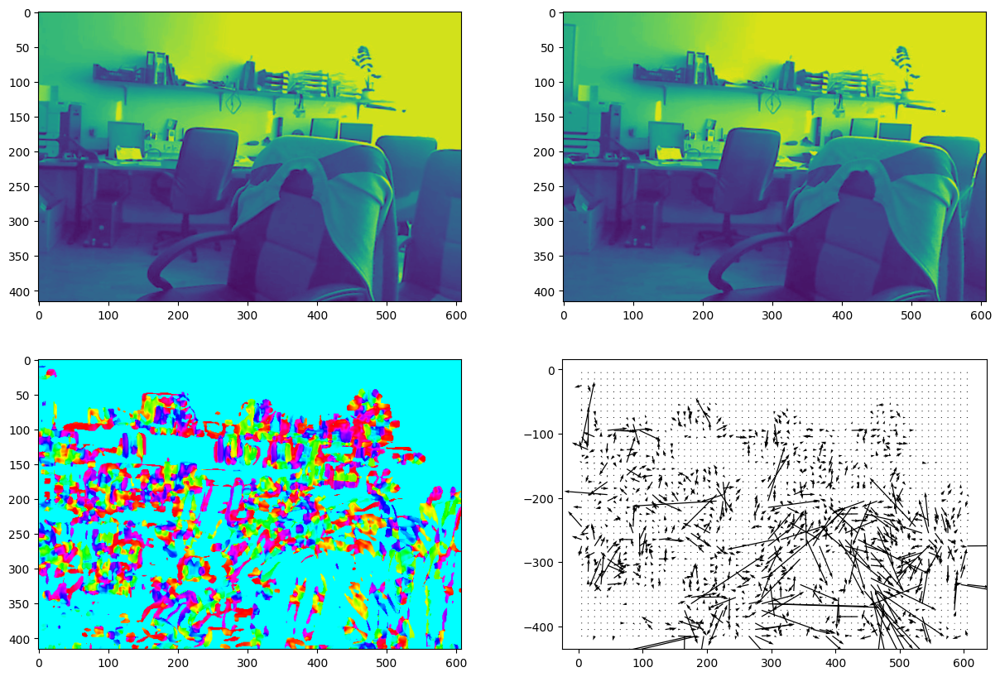

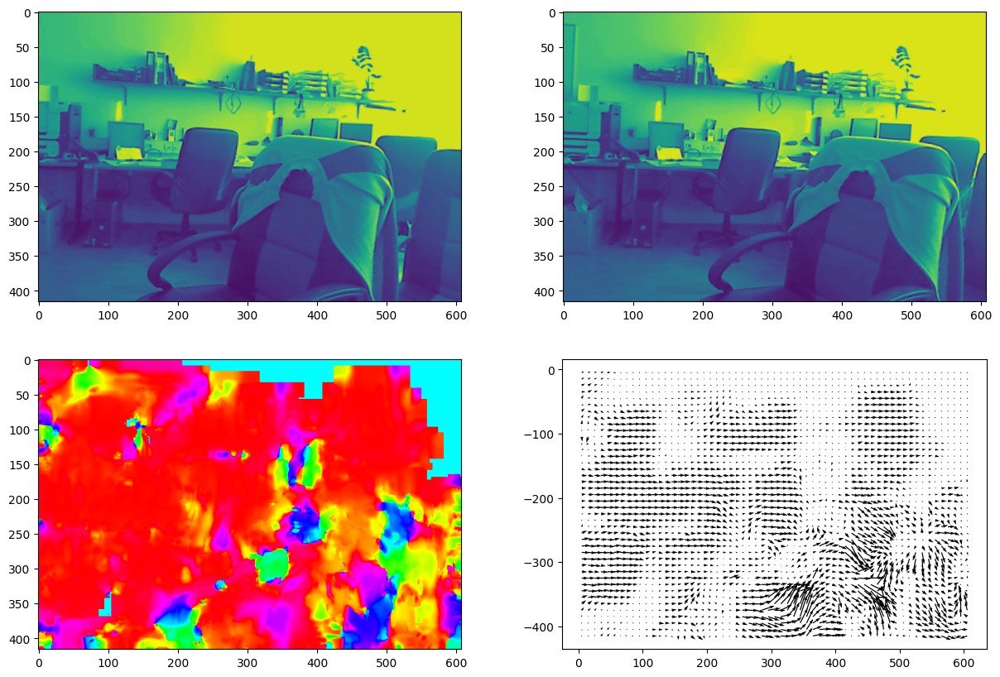

In [ ]:
# Changes of the smaller objects in the background as well as closer objects are nicely captured
im1 = cv2.imread("disparity/office_left.png", cv2.IMREAD_GRAYSCALE)/255.0
im2 = cv2.imread("disparity/office_right.png",cv2.IMREAD_GRAYSCALE)/255.0
N = 9 #for LK  
sigma = im1.shape[0]/200
subplot_field_lk(im1,im2,N, sigma, True)
subplot_field_lk_pyramid(im1,im2,N, sigma) 

In [ ]:
np.random.seed(42)
im1 = np.random.rand(200,200).astype(np.float32)
im2 = im1.copy()
im2 = rotate_image(im2,-1)
u,v = hornschunck(im1,im2, 1000, 0.5, 1, 1e-7)
subplot_field_hc(im1,im2,1000, 0.5, 1, 1e-7)

# Get coordinate matrices
h, w = im1.shape
x, y = np.meshgrid(np.arange(w), np.arange(h))

# Add the flow field to the coordinate matrices, to tell cv2 where to map the pixels
map_x = (x - u).astype(np.float32)
map_y = (y - v).astype(np.float32)
warped = cv2.remap(im2, map_x, map_y, interpolation=cv2.INTER_LINEAR)

plt.figure()
plt.imshow(warped)